In [1]:
!pip install --upgrade pingouin

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import datetime
import random
import statistics
from math import pi
from matplotlib.gridspec import GridSpec
from dateutil.relativedelta import *
import matplotlib.dates as mdates
from matplotlib.dates import DateFormatter
import seaborn as sns
import scipy.stats
import pingouin as pg

In [3]:
# COMMON VARIABLES

alg_to_analyze = [
    'sentilexpt_sentiment_analysis_score',
    'sentilexpt_sentiment_analysis_polarity'
]

tpd_columns = ["text", "created_at", "id_user", "vader_sentiment_analysis_score", "vader_sentiment_analysis_polarity",
                         "oplexicon_sentiment_analysis_score", "oplexicon_sentiment_analysis_polarity",
                         "sentistrength_sentiment_analysis_score", "sentistrength_sentiment_analysis_polarity",
                         "sentilexpt_sentiment_analysis_score", "sentilexpt_sentiment_analysis_polarity",
                         "final_score", "final_polarity"]

clean_df_columns = [
    'text',
    'final_score',
    'final_polarity',
    'oplexicon_sentiment_analysis_score',
    'oplexicon_sentiment_analysis_polarity',
    'sentistrength_sentiment_analysis_score',
    'sentistrength_sentiment_analysis_polarity',
    'vader_sentiment_analysis_score',
    'vader_sentiment_analysis_polarity'
]

In [4]:
!python3 '/Users/leosilva/development/thesis/workspacePyCharm/TwitterDataMining/main_generate_json_files.py'

Starting script...
Removing existing file...
Ending script...


In [5]:
data = pd.read_json(r'/Users/leosilva/development/thesis/workspacePyCharm/TwitterDataMining/alldata.json')
data.head()

,26,27,28,29,30,31,32,33,34,35,36,37
id_str_twitter,23781146,15148309,927028057763995648,77648005,3429765093,10794662,1034514325644431361,529445600,12050562,62314491,18289937,172880784
name,Fe Rebelatto,Sommelier de Airbnb,✪ Felippe,Conference Distinguished Specialist,Paula Santana,Maharaja of the Legacies,Jessica,"var nickname = ""Riquettinha"";",Roberta Arcoverde,Gabriela,Thamara Andrade,felipe.ts ⚡
screen_name,rebelatto,Guilh_rm_,FelippeRegazio,NannoKa,psanrosa13,rponte,dev_jessi,Riquettinha,rla4,Gabrielathalita,thamyk,felipefialho_
location,"Rio de Janeiro, Brasil",somewhere in Brazil,,Ctba-PR Brasil,Brasil,"Ceará, Brazil",São Paulo - Brasil,"Belo Horizonte, Brasil","Sao Paulo, Brazil",Belo Horizonte,"Belo Horizonte, Brazil.",Dark Side of the Moon
url,None,https://t.co/gX4oRZWHg3,https://t.co/KkaPlVH4Wu,https://t.co/hDni4Fh2Ng,https://t.co/YJQuDtv2YW,https://t.co/3yZ94QNQvs,https://t.co/MtUeSEBICu,https://t.co/QU71LJgSuD,None,https://t.co/AmkOKWlftK,https://t.co/JWBzdmQOcV,https://t.co/yPuEuh1bn9


In [6]:
def clean_df(df):
    for c in clean_df_columns:
        del df[c]

In [7]:
def create_tweets_pd(data, id_user):

    tweets_pd = pd.DataFrame(data[id_user]['tweets'])
    del tweets_pd[0]
    del tweets_pd[1]
    del tweets_pd[4]
    del tweets_pd[5]
    del tweets_pd[6]
    del tweets_pd[18]
    
    tweets_pd.columns = ["text", "created_at", "id_user", "vader_sentiment_analysis_score", "vader_sentiment_analysis_polarity",
                         "oplexicon_sentiment_analysis_score", "oplexicon_sentiment_analysis_polarity",
                         "sentistrength_sentiment_analysis_score", "sentistrength_sentiment_analysis_polarity",
                         "sentilexpt_sentiment_analysis_score", "sentilexpt_sentiment_analysis_polarity",
                         "final_score", "final_polarity"]
 
    return tweets_pd

In [8]:
def create_line_plot(df_result, id_user):
    df_result["created_at"] = pd.to_datetime(df_result["created_at"])
    df_result['date_minus_time'] = df_result["created_at"].apply( lambda df_result : datetime.datetime(year=df_result.year, month=df_result.month, day=df_result.day))
    df_result.set_index(df_result["date_minus_time"],inplace=True)

    new_df = pd.DataFrame(df_result[alg_to_analyze[0]].resample('W').mean())

    new_df['week'] = range(1, len(new_df.index) + 1)

    x = new_df["week"]
    y = new_df[alg_to_analyze[0]]

    tickvalues = range(0, int(len(x)), 2)

    if len(tickvalues) > len(x[1::2]):
        tickvalues = range(0, int(len(x)) - (len(tickvalues) - len(x[1::2])), 2)

    fig = plt.figure(figsize=(16,6))

    plt.xticks(ticks = tickvalues ,labels = x[1::2], rotation = 'vertical')

    plt.title("Tweets Sentilexpt polarity per week - Participant {}".format(id_user))
    plt.ylabel("Polarity")
    plt.xlabel("Weeks")

    plt.axhline(y.mean(), color='k', linestyle='dashed', linewidth=1)
    min_ylim, max_ylim = plt.ylim()
    plt.text(y.mean()*0.05, max_ylim*0.12, 'Mean: {:.2f}'.format(y.mean()))

    plt.plot(x,y)

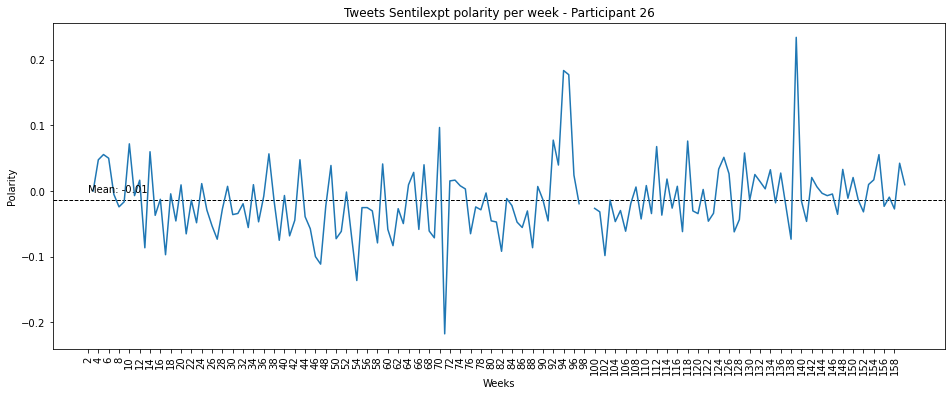

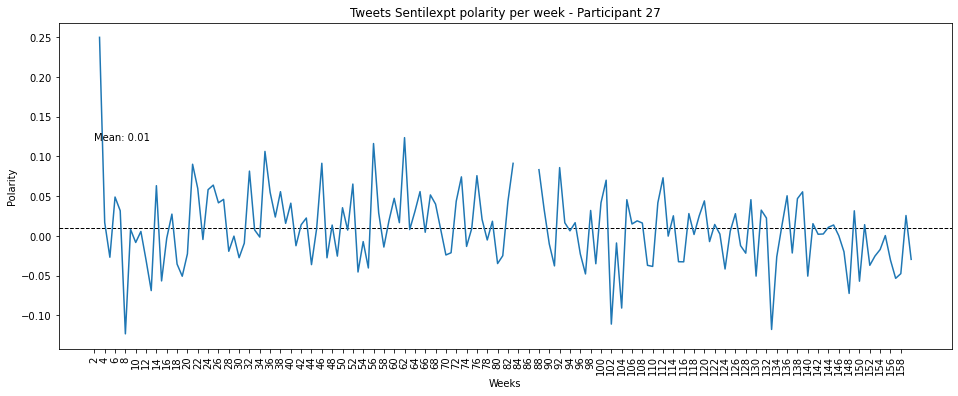

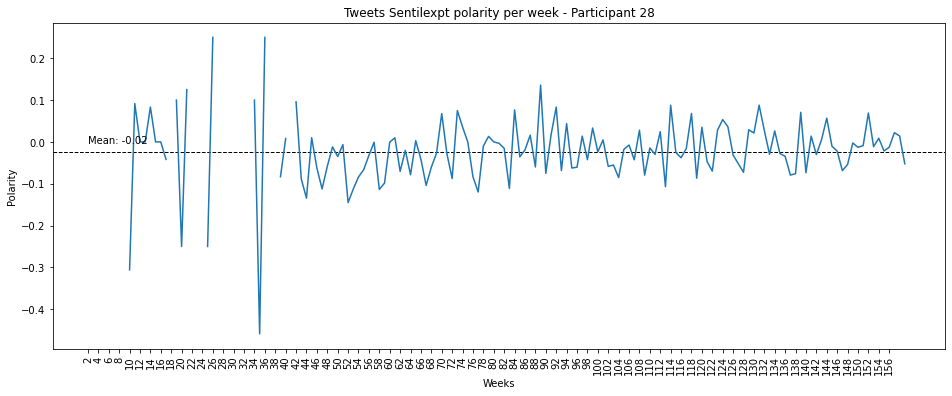

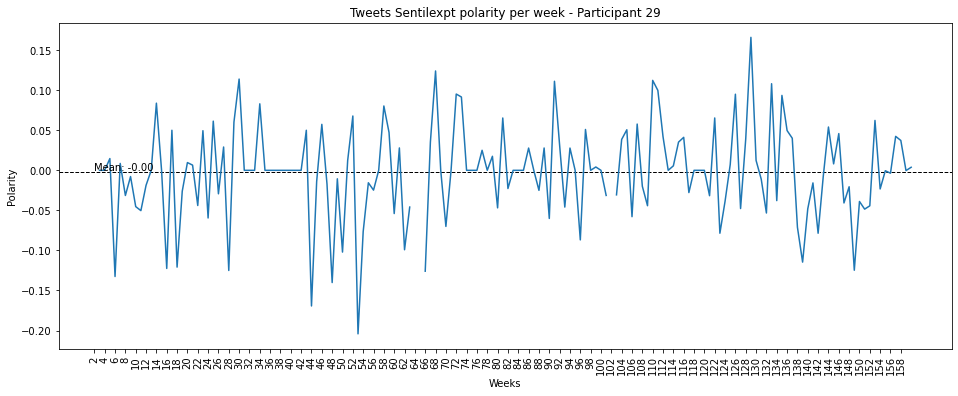

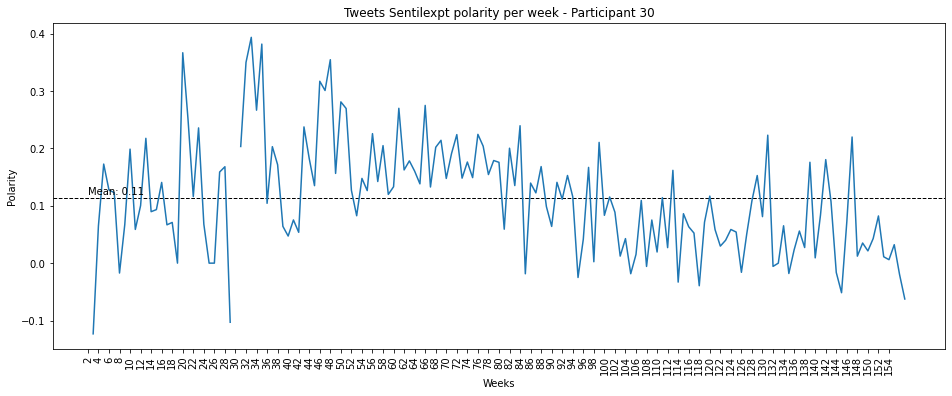

...

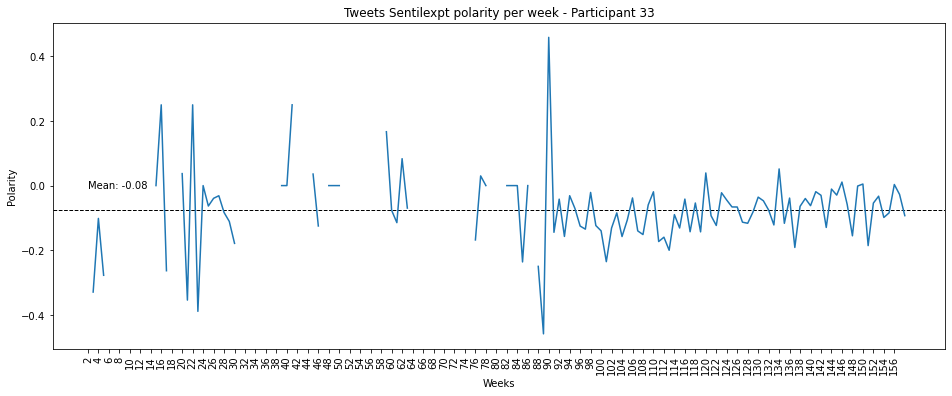

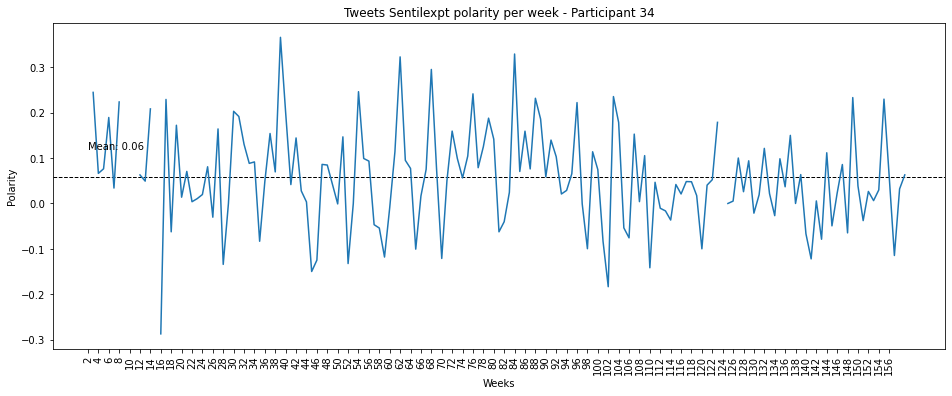

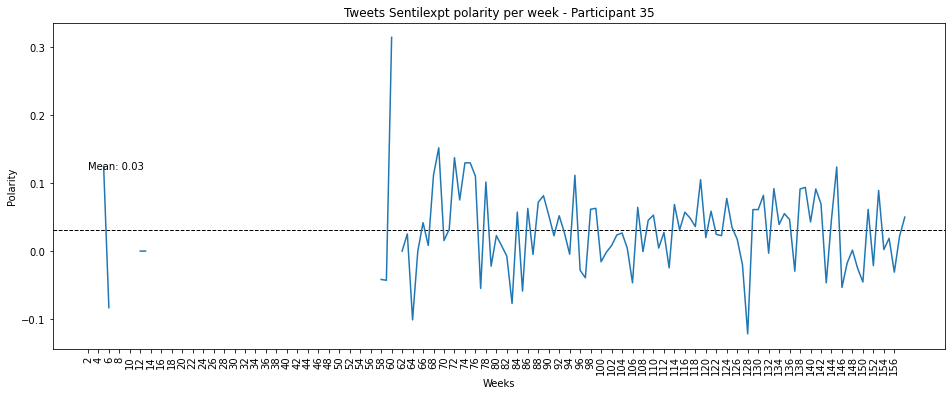

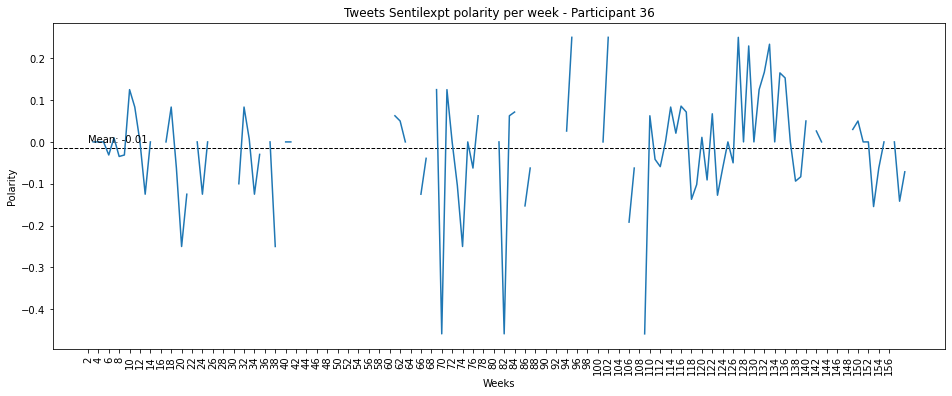

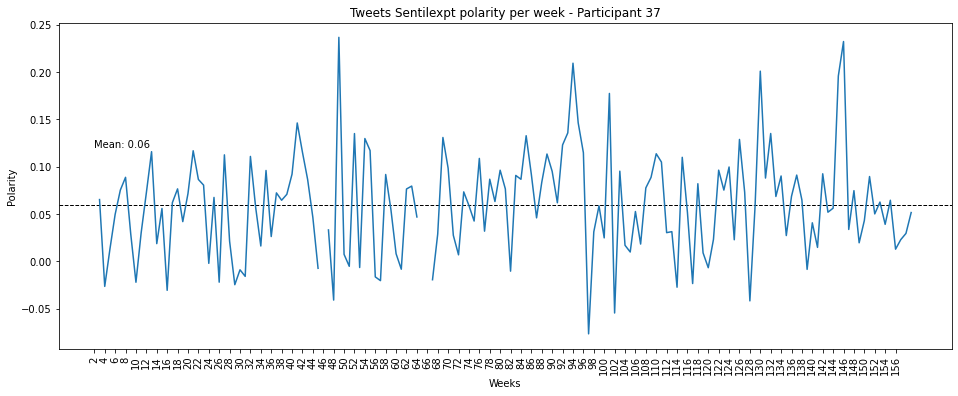

In [9]:
for c in data:
    id_user = c
    tweets_pd = create_tweets_pd(data, id_user)
    
    create_line_plot(tweets_pd, id_user)

In [10]:
# DATA CONSIDERING THE NEUTRAL POLARITY

df_dict = {'id_user' : [],
            'pos' : [],
            'neu' : [],
            'neg' : [],
            'por_pos' : [],
            'por_neu' : [],
            'por_neg' : [],
            'mean' : []
          }

for c in data:
    id_user = c
    print('id_user: {}'.format(id_user))
    print('lexicon: Sentilexpt')
    tweets_pd = create_tweets_pd(data, id_user)
    vader_df = tweets_pd[['id_user', alg_to_analyze[0], alg_to_analyze[1]]].copy()
    print('mean: {}'.format(vader_df[alg_to_analyze[0]].mean()))
    qtd_pos = vader_df.query(alg_to_analyze[1] + ' == "pos"')['id_user'].count()
    qtd_neu = vader_df.query(alg_to_analyze[1] + ' == "neu"')['id_user'].count()
    qtd_neg = vader_df.query(alg_to_analyze[1] + ' == "neg"')['id_user'].count()
    qtd_total = vader_df[alg_to_analyze[1]].count()
    print('pos: {}'.format(qtd_pos))
    print('neu: {}'.format(qtd_neu))
    print('neg: {}'.format(qtd_neg))
    print('% pos: {}'.format((qtd_pos / qtd_total) * 100))
    print('% neu: {}'.format((qtd_neu / qtd_total) * 100))
    print('% neg: {}'.format((qtd_neg / qtd_total) * 100))
    print('')
    df_dict['id_user'].append(id_user)
    df_dict['pos'].append(qtd_pos)
    df_dict['neu'].append(qtd_neu)
    df_dict['neg'].append(qtd_neg)
    df_dict['por_pos'].append((qtd_pos / qtd_total) * 100)
    df_dict['por_neu'].append((qtd_neu / qtd_total) * 100)
    df_dict['por_neg'].append((qtd_neg / qtd_total) * 100)
    df_dict['mean'].append(vader_df[alg_to_analyze[0]].mean())

df_chart = pd.DataFrame(df_dict)
df_chart
    

id_user: 26
lexicon: Sentilexpt
mean: -0.016055009089104982
pos: 1200
neu: 2476
neg: 1363
% pos: 23.814248858900573
% neu: 49.136733478864855
% neg: 27.04901766223457

id_user: 27
lexicon: Sentilexpt
mean: 0.004248512301604738
pos: 1158
neu: 2406
neg: 985
% pos: 25.456144207518133
% neu: 52.89074521872939
% neg: 21.653110573752475

id_user: 28
lexicon: Sentilexpt
mean: -0.01582306871734369
pos: 1538
neu: 2742
neg: 1653
% pos: 25.92280465194674
% neu: 46.21607955503118
% neg: 27.86111579302208

id_user: 29
lexicon: Sentilexpt
mean: -0.002688394953717535
pos: 907
neu: 1590
neg: 852
% pos: 27.082711257091667
% neu: 47.47685876381009
% neg: 25.44042997909824

id_user: 30
lexicon: Sentilexpt
mean: 0.11187166677490562
pos: 1547
neu: 1084
neg: 541
% pos: 48.77049180327869
% neu: 34.17402269861286
% neg: 17.05548549810845

id_user: 31
lexicon: Sentilexpt
mean: 0.03964145385590424
pos: 2501
neu: 1948
neg: 1547
% pos: 41.71114076050701
% neu: 32.48832555036691
% neg: 25.80053368912608

id_user: 

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean
0,26,1200,2476,1363,23.814249,49.136733,27.049018,-0.016055
1,27,1158,2406,985,25.456144,52.890745,21.653111,0.004249
2,28,1538,2742,1653,25.922805,46.216080,27.861116,-0.015823
3,29,907,1590,852,27.082711,47.476859,25.440430,-0.002688
4,30,1547,1084,541,48.770492,34.174023,17.055485,0.111872
5,31,2501,1948,1547,41.711141,32.488326,25.800534,0.039641
6,32,3609,3644,1921,39.339438,39.720951,20.939612,0.054171
7,33,526,875,930,22.565423,37.537538,39.897040,-0.077845
8,34,562,664,319,36.375405,42.977346,20.647249,0.051674
9,35,777,1262,556,29.942197,48.631985,21.425819,0.034614


In [11]:
# DATA WITHOUT THE NEUTRAL POLARITY

df_dict = {'id_user' : [],
            'pos' : [],
            'neu' : [],
            'neg' : [],
            'por_pos' : [],
            'por_neu' : [],
            'por_neg' : [],
            'mean_all' : [],
            'mean_posneg' : []
          }

for c in data:
    id_user = c
    print('id_user: {}'.format(id_user))
    print('lexicon: Sentilexpt')
    tweets_pd = create_tweets_pd(data, id_user)
    vader_df = tweets_pd[['id_user', alg_to_analyze[0], alg_to_analyze[1]]].copy()
    final_score = vader_df.query(alg_to_analyze[1] + ' == "pos"')[alg_to_analyze[0]].tolist()
    final_score.extend(vader_df.query(alg_to_analyze[1] + ' == "neg"')[alg_to_analyze[0]].tolist())
    print(len(final_score))
    print(statistics.mean(final_score))
    print('mean: {}'.format(vader_df[alg_to_analyze[0]].mean()))
    qtd_pos = vader_df.query(alg_to_analyze[1] + ' == "pos"')['id_user'].count()
    qtd_neu = vader_df.query(alg_to_analyze[1] + ' == "neu"')['id_user'].count()
    qtd_neg = vader_df.query(alg_to_analyze[1] + ' == "neg"')['id_user'].count()
    qtd_total = vader_df[alg_to_analyze[1]].count()
    print('pos: {}'.format(qtd_pos))
    print('neu: {}'.format(qtd_neu))
    print('neg: {}'.format(qtd_neg))
    print('% pos: {}'.format((qtd_pos / qtd_total) * 100))
    print('% neu: {}'.format((qtd_neu / qtd_total) * 100))
    print('% neg: {}'.format((qtd_neg / qtd_total) * 100))
    print('')
    df_dict['id_user'].append(id_user)
    df_dict['pos'].append(qtd_pos)
    df_dict['neu'].append(qtd_neu)
    df_dict['neg'].append(qtd_neg)
    df_dict['por_pos'].append((qtd_pos / qtd_total) * 100)
    df_dict['por_neu'].append((qtd_neu / qtd_total) * 100)
    df_dict['por_neg'].append((qtd_neg / qtd_total) * 100)
    df_dict['mean_all'].append(vader_df[alg_to_analyze[0]].mean())
    df_dict['mean_posneg'].append(statistics.mean(final_score))

df_chart = pd.DataFrame(df_dict)
df_chart
    

id_user: 26
lexicon: Sentilexpt
2563
-0.03156503737807257
mean: -0.016055009089104982
pos: 1200
neu: 2476
neg: 1363
% pos: 23.814248858900573
% neu: 49.136733478864855
% neg: 27.04901766223457

id_user: 27
lexicon: Sentilexpt
2143
0.009018423919738686
mean: 0.004248512301604738
pos: 1158
neu: 2406
neg: 985
% pos: 25.456144207518133
% neu: 52.89074521872939
% neg: 21.653110573752475

id_user: 28
lexicon: Sentilexpt
3191
-0.02941970125352554
mean: -0.01582306871734369
pos: 1538
neu: 2742
neg: 1653
% pos: 25.92280465194674
% neu: 46.21607955503118
% neg: 27.86111579302208

id_user: 29
lexicon: Sentilexpt
1759
-0.0051184961341671385
mean: -0.002688394953717535
pos: 907
neu: 1590
neg: 852
% pos: 27.082711257091667
% neu: 47.47685876381009
% neg: 25.44042997909824

id_user: 30
lexicon: Sentilexpt
2088
0.16995063554118775
mean: 0.11187166677490562
pos: 1547
neu: 1084
neg: 541
% pos: 48.77049180327869
% neu: 34.17402269861286
% neg: 17.05548549810845

id_user: 31
lexicon: Sentilexpt
4048
0.058

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean_all,mean_posneg
0,26,1200,2476,1363,23.814249,49.136733,27.049018,-0.016055,-0.031565
1,27,1158,2406,985,25.456144,52.890745,21.653111,0.004249,0.009018
2,28,1538,2742,1653,25.922805,46.216080,27.861116,-0.015823,-0.029420
3,29,907,1590,852,27.082711,47.476859,25.440430,-0.002688,-0.005118
4,30,1547,1084,541,48.770492,34.174023,17.055485,0.111872,0.169951
5,31,2501,1948,1547,41.711141,32.488326,25.800534,0.039641,0.058718
6,32,3609,3644,1921,39.339438,39.720951,20.939612,0.054171,0.089868
7,33,526,875,930,22.565423,37.537538,39.897040,-0.077845,-0.124627
8,34,562,664,319,36.375405,42.977346,20.647249,0.051674,0.090621
9,35,777,1262,556,29.942197,48.631985,21.425819,0.034614,0.067384


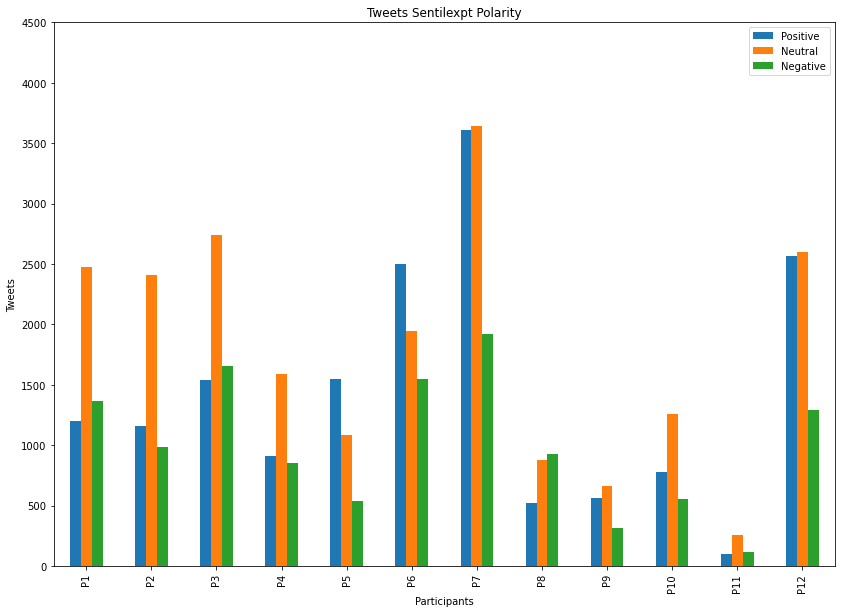

In [12]:
# multiple bar plots

bar_chart_data = []

y_range = range(0,4501, 500)

for i in df_chart.index:
    d = ['P{}'.format(i+1), df_chart.iloc[i]['pos'], df_chart.iloc[i]['neu'], df_chart.iloc[i]['neg']]
    bar_chart_data.append(d)

df = pd.DataFrame(bar_chart_data, columns=["Participant","pos","neu","neg"])
df.plot(yticks = y_range, x="Participant", y=["pos", "neu", "neg"], kind="bar",figsize=(14,10))

plt.legend(["Positive", "Neutral", "Negative"])
plt.title('Tweets Sentilexpt Polarity')
plt.xlabel('Participants')
plt.ylabel('Tweets')

plt.show()

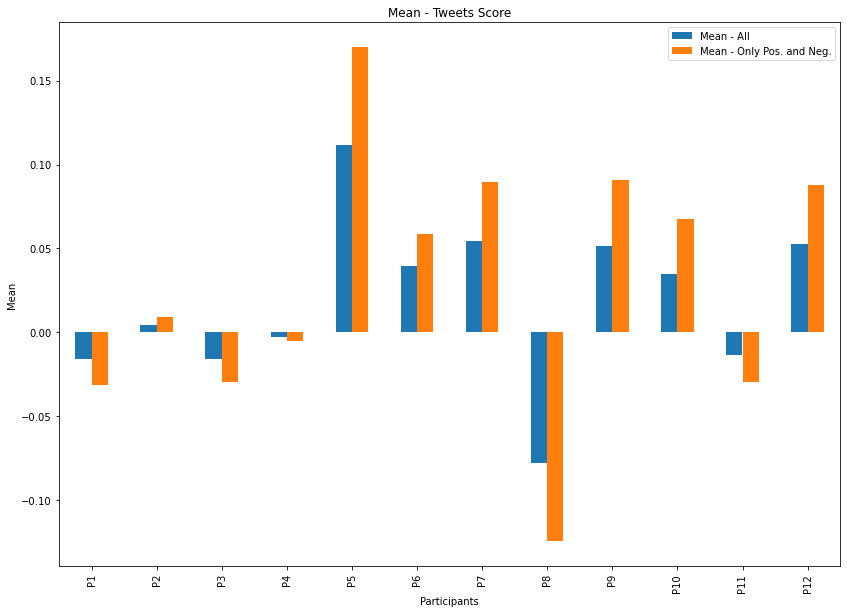

In [13]:
# multiple bar plots with means

bar_chart_data = []

y_range = range(-1,1)

for i in df_chart.index:
    d = ['P{}'.format(i+1), df_chart.iloc[i]['mean_all'], df_chart.iloc[i]['mean_posneg']]
    bar_chart_data.append(d)

df = pd.DataFrame(bar_chart_data, columns=["Participant","mean_all","mean_posneg"])
df.plot(x="Participant", y=["mean_all", "mean_posneg"], kind="bar",figsize=(14,10))

plt.legend(["Mean - All", "Mean - Only Pos. and Neg."])
plt.title('Mean - Tweets Score')
plt.xlabel('Participants')
plt.ylabel('Mean')

plt.show()

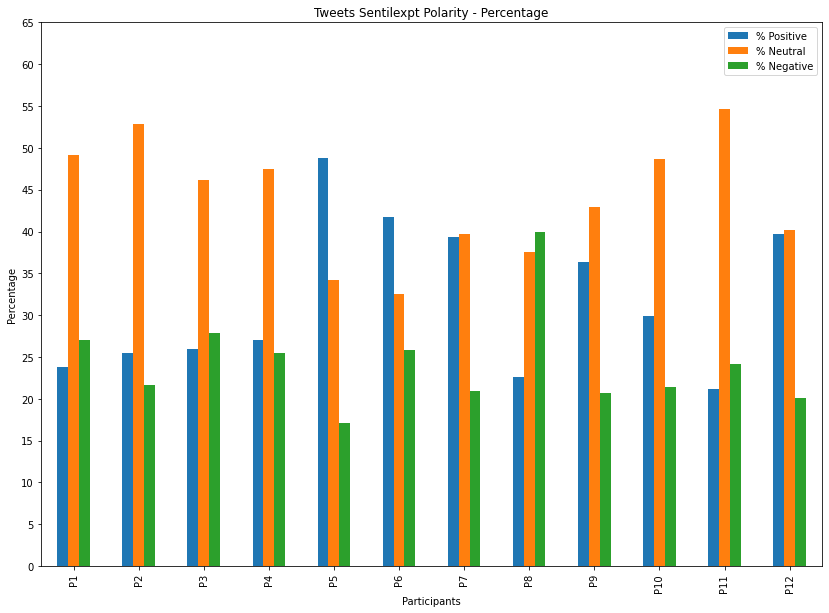

In [14]:
# multiple line plots

bar_chart_data = []

y_range = range(0, 70, 5)

for i in df_chart.index:
    d = ['P{}'.format(i+1), df_chart.iloc[i]['por_pos'], df_chart.iloc[i]['por_neu'], df_chart.iloc[i]['por_neg']]
    bar_chart_data.append(d)

df = pd.DataFrame(bar_chart_data, columns=["Participant","por_pos","por_neu","por_neg"])
df.plot(yticks = y_range, x="Participant", y=["por_pos", "por_neu", "por_neg"], kind="bar",figsize=(14,10))


plt.legend(['% Positive', '% Neutral', '% Negative'])
plt.title('Tweets Sentilexpt Polarity - Percentage')
plt.xlabel('Participants')
plt.ylabel('Percentage')

plt.show()

In [15]:
bigfive = {}

for c in data:
    id_user = c

    df_bf = pd.DataFrame(data[id_user]['bigfive'])
    
    if df_bf.empty == False:
        id = int(df_bf[6])

        del df_bf[0]
        del df_bf[6]

        df_bf.columns = ['O', 'C', 'E', 'A', 'N']

        bigfive[id] = df_bf

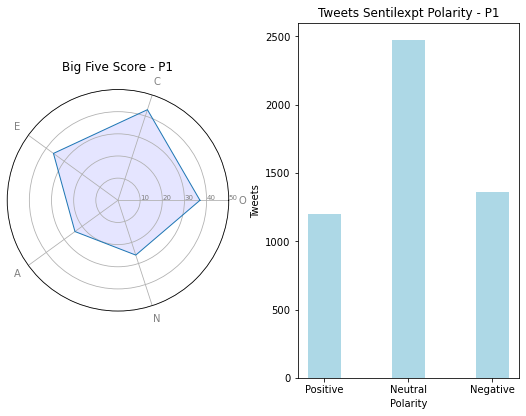

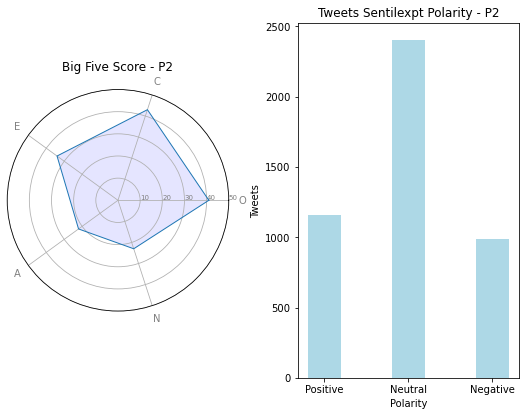

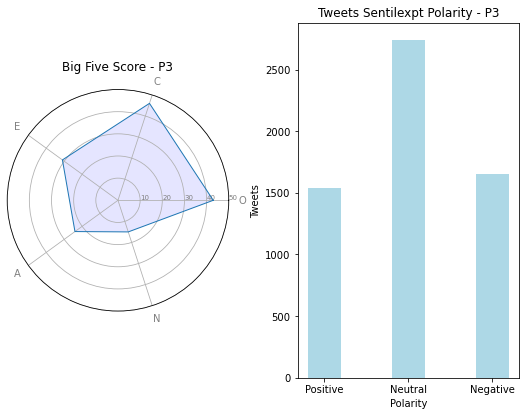

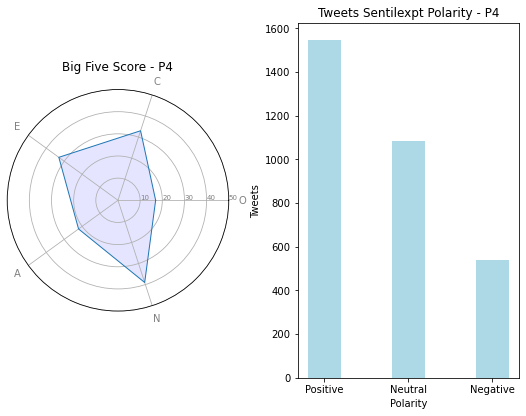

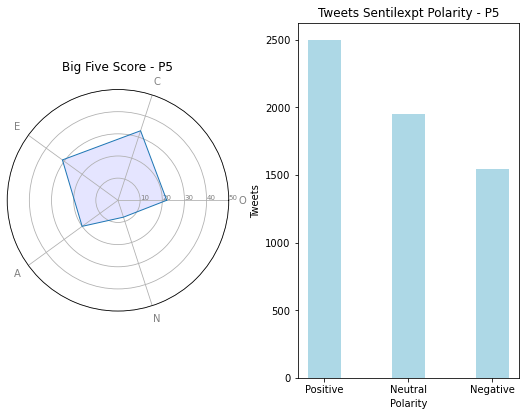

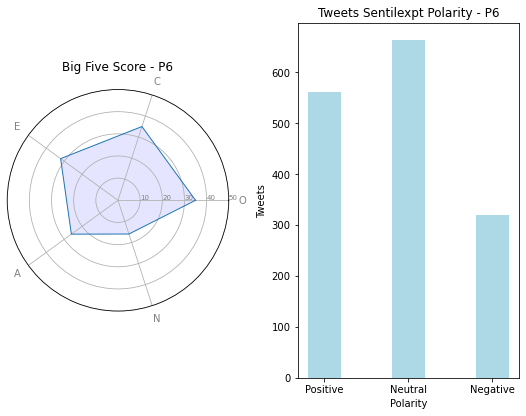

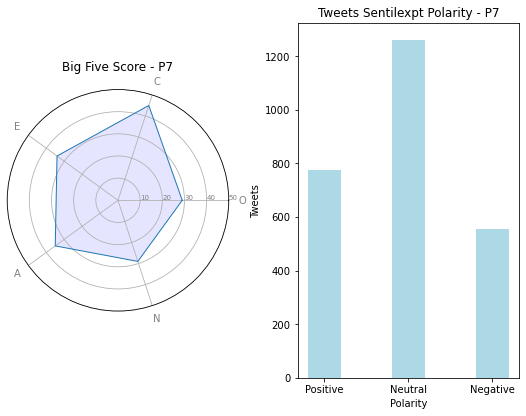

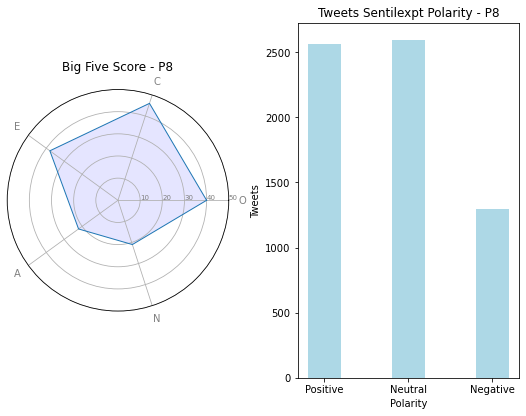

In [16]:
count = 1

for i in bigfive:
    b = bigfive[i]

    o = [b['O']]
    c = [b['C']]
    e = [b['E']]
    a = [b['A']]
    n = [b['N']]

    # Set data
    df = pd.DataFrame({
    'group': ['A'],
    'O': o,
    'C': c,
    'E': e,
    'A': a,
    'N': n
    })

    # number of variable
    categories=list(df)[1:]
    N = len(categories)

    # We are going to plot the first line of the data frame.
    # But we need to repeat the first value to close the circular graph:
    values=df.loc[0].drop('group').values.flatten().tolist()
    values += values[:1]
    values

    # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
    angles = [n / float(N) * 2 * pi for n in range(N)]
    angles += angles[:1]

    
    fig = plt.figure(figsize=(8, 6))
    gs = GridSpec(nrows=1, ncols=2)
    
    # Initialise the spider plot
    ax = fig.add_subplot(gs[0, 0])
    ax = plt.subplot(121, polar=True)

    # Draw one axe per variable + add labels
    plt.xticks(angles[:-1], categories, color='grey', size=10)

    # Draw ylabels
    ax.set_rlabel_position(0)
    plt.yticks([10,20,30, 40, 50], ["10","20","30", '40', '50'], color="grey", size=7)
    plt.ylim(0,50)

    # Plot data
    ax.plot(angles, values, linewidth=1, linestyle='solid')

    # Fill area
    ax.fill(angles, values, 'b', alpha=0.1)
    
    plt.title('Big Five Score - P{}'.format(count))
    
#     plt.tight_layout()

    # Show the graph
#     plt.show()
    
    plt.subplot(122)
    
    y_range = range(0,6001, 500)

    d = {"Positive": int(df_chart.query('id_user == {}'.format(i))['pos']), 
         "Neutral": int(df_chart.query('id_user == {}'.format(i))['neu']), 
         "Negative": int(df_chart.query('id_user == {}'.format(i))['neg'])}
    
#     plt.figure(figsize = (8, 6))

    plt.tight_layout(pad=2.8)
#     plt.subplot_tool()
 
    # creating the bar plot
    plt.bar(d.keys(), d.values(), width = 0.4, color = 'lightblue')

    plt.title('Tweets Sentilexpt Polarity - P{}'.format(count))
    plt.xlabel('Polarity')
    plt.ylabel('Tweets')

    plt.show()
    
    count += 1

In [17]:
df_chart

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean_all,mean_posneg
0,26,1200,2476,1363,23.814249,49.136733,27.049018,-0.016055,-0.031565
1,27,1158,2406,985,25.456144,52.890745,21.653111,0.004249,0.009018
2,28,1538,2742,1653,25.922805,46.216080,27.861116,-0.015823,-0.029420
3,29,907,1590,852,27.082711,47.476859,25.440430,-0.002688,-0.005118
4,30,1547,1084,541,48.770492,34.174023,17.055485,0.111872,0.169951
5,31,2501,1948,1547,41.711141,32.488326,25.800534,0.039641,0.058718
6,32,3609,3644,1921,39.339438,39.720951,20.939612,0.054171,0.089868
7,33,526,875,930,22.565423,37.537538,39.897040,-0.077845,-0.124627
8,34,562,664,319,36.375405,42.977346,20.647249,0.051674,0.090621
9,35,777,1262,556,29.942197,48.631985,21.425819,0.034614,0.067384


[Text(1, 0, 'Positive'), Text(2, 0, 'Negative'), Text(3, 0, 'Neutral')]

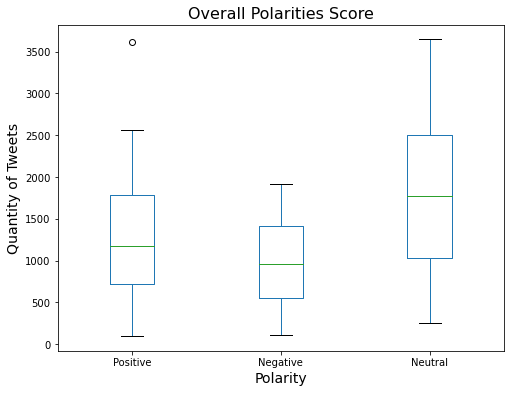

In [18]:
bplot = df_chart.boxplot(column=['pos', 'neg', 'neu'], grid=False, figsize=(8,6))

bplot.axes.set_title("Overall Polarities Score", fontsize=16)
 
bplot.set_xlabel("Polarity", fontsize=14) 
bplot.set_ylabel("Quantity of Tweets", fontsize=14)
bplot.tick_params(labelsize=10)
bplot.set_xticklabels(['Positive', 'Negative', 'Neutral'])

[Text(1, 0, 'Positive (%)'),
 Text(2, 0, 'Negative (%)'),
 Text(3, 0, 'Neutral (%)')]

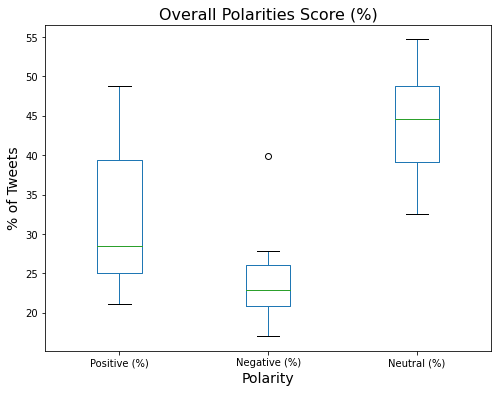

In [19]:
bplot = df_chart.boxplot(column=['por_pos', 'por_neg', 'por_neu'], grid=False, figsize=(8,6))

bplot.axes.set_title("Overall Polarities Score (%)", fontsize=16)
 
bplot.set_xlabel("Polarity", fontsize=14) 
bplot.set_ylabel("% of Tweets", fontsize=14)
bplot.tick_params(labelsize=10)
bplot.set_xticklabels(['Positive (%)', 'Negative (%)', 'Neutral (%)'])

[Text(1, 0, 'All Polarities'), Text(2, 0, 'Only Positives and Negatives')]

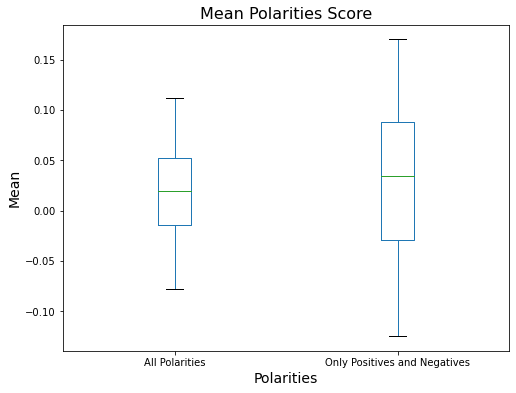

In [20]:
bplot = df_chart.boxplot(column=['mean_all', 'mean_posneg'], grid=False, figsize=(8,6))

bplot.axes.set_title("Mean Polarities Score", fontsize=16)
 
bplot.set_xlabel("Polarities", fontsize=14) 
bplot.set_ylabel("Mean", fontsize=14)
bplot.tick_params(labelsize=10)
bplot.set_xticklabels(['All Polarities', 'Only Positives and Negatives'])

In [21]:
def plot_point_chart(df, count, id_user):

    first_date = df.iloc[0]['date_minus_time']
    
    for i in range(1,13):
        end_date = first_date + relativedelta(months=+3)
        mask = (df['created_at'] >= first_date) & (df['created_at'] < end_date)
        new_df = df.loc[mask]
        
        fig, ax = plt.subplots(figsize=(24, 8))
    
        x = new_df['date_minus_time']
        y = new_df[alg_to_analyze[0]]

        x_ticks = x

        colors = {'pos':'green', 'neu':'orange', 'neg':'red'}

        plt.yticks(np.arange(-1.0, 1.1, 0.1), fontsize=16)
        plt.xticks(x_ticks, rotation='vertical', fontsize=16)

        date_form = DateFormatter("%Y-%m-%d")
        ax.xaxis.set_major_formatter(date_form)
        plt.xlabel('Day', fontsize=16)
        plt.ylabel('Polarity Sentilexpt Score', fontsize=16)
        
        plt.title('Scatter Plot - Sentilexpt - P{}, User {} - From {} To {}'.format(count, id_user, first_date.strftime("%Y-%m-%d"), end_date.strftime("%Y-%m-%d")), fontsize=20)
        
        plt.rcParams.update({
            "savefig.facecolor": (1.0, 1.0, 1.0)
        })
        
#         plt.legend()

        plt.scatter(x, y, alpha=0.7, c=new_df[alg_to_analyze[1]].map(colors))
        
#         plt.savefig('images/scatter_P{}_U{}_{}_{}.pdf'.format(count, id_user, first_date.strftime("%Y-%m-%d"), end_date.strftime("%Y-%m-%d")),bbox_inches='tight',transparent=False)
        
        first_date = end_date

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
/Users/leosilva/opt/anaconda3/lib/python3.7/site-packages/ip

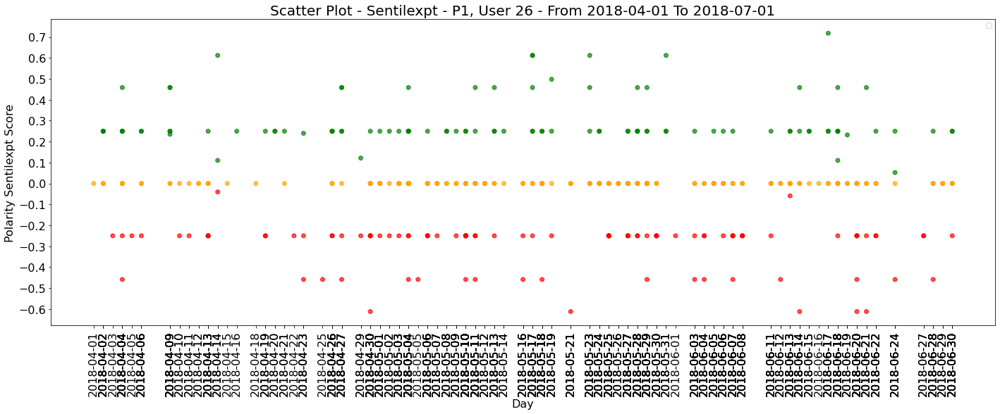

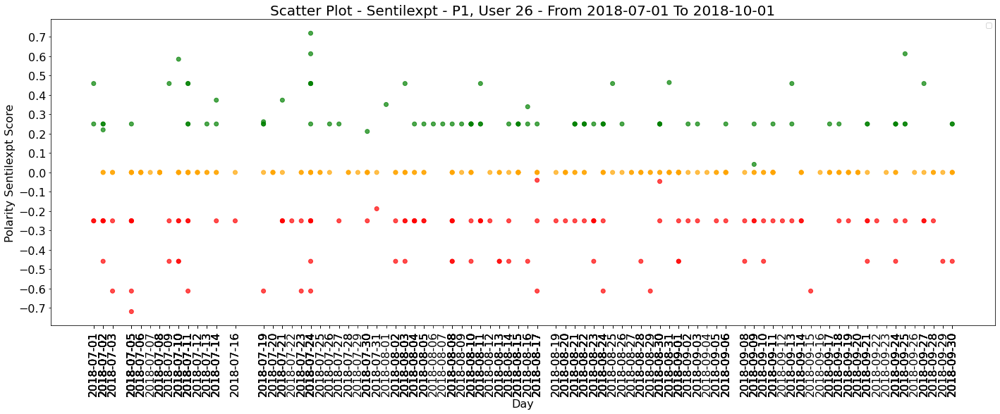

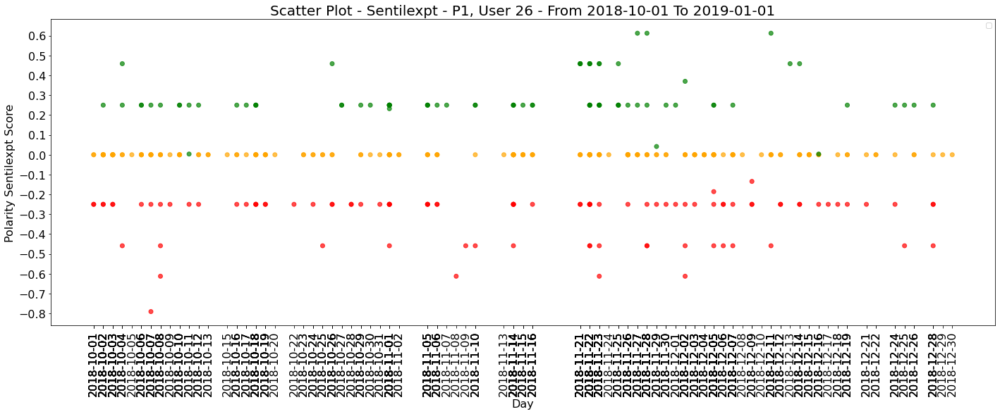

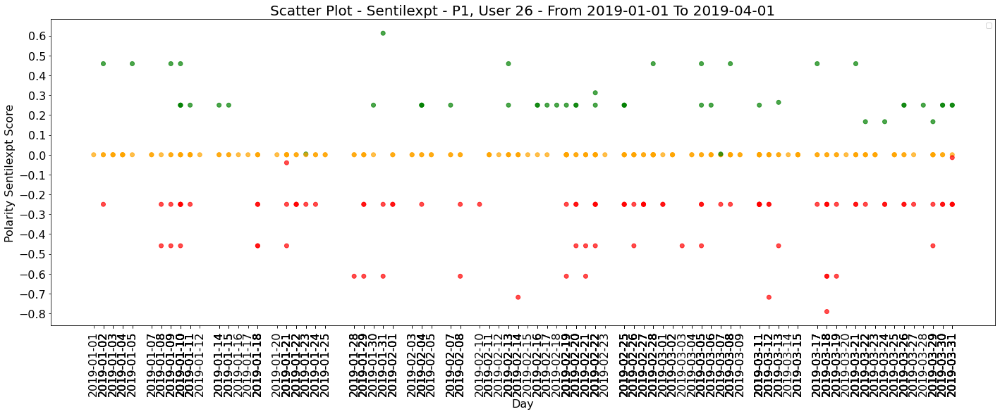

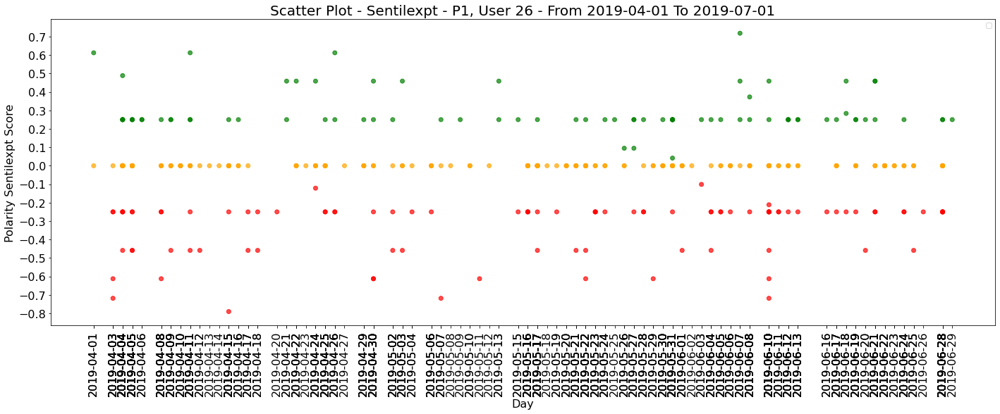

...

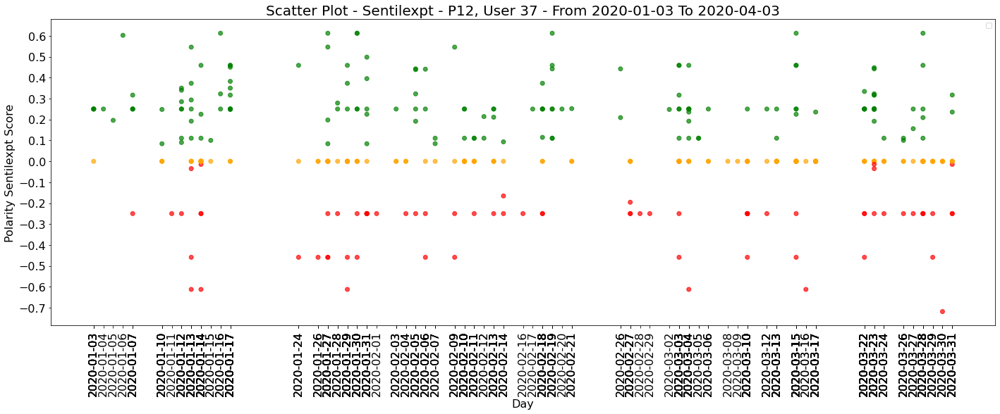

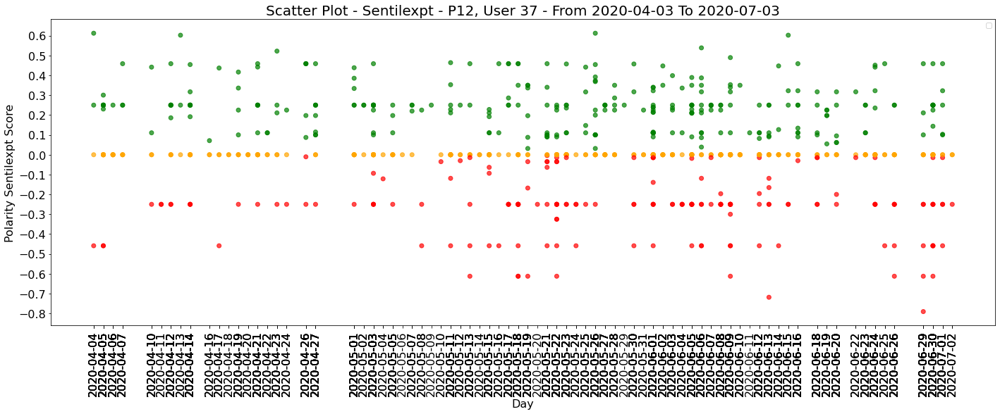

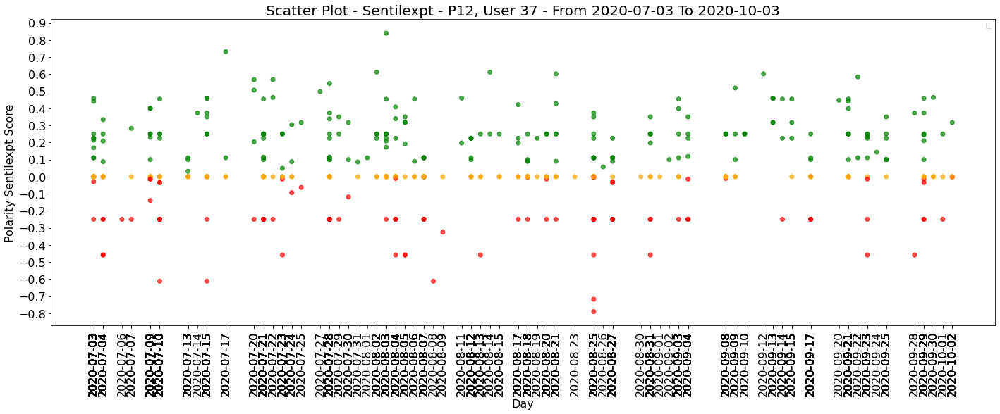

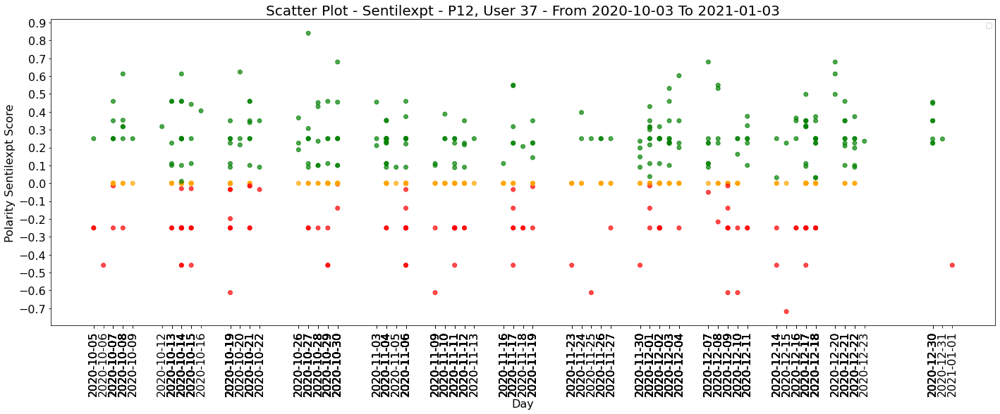

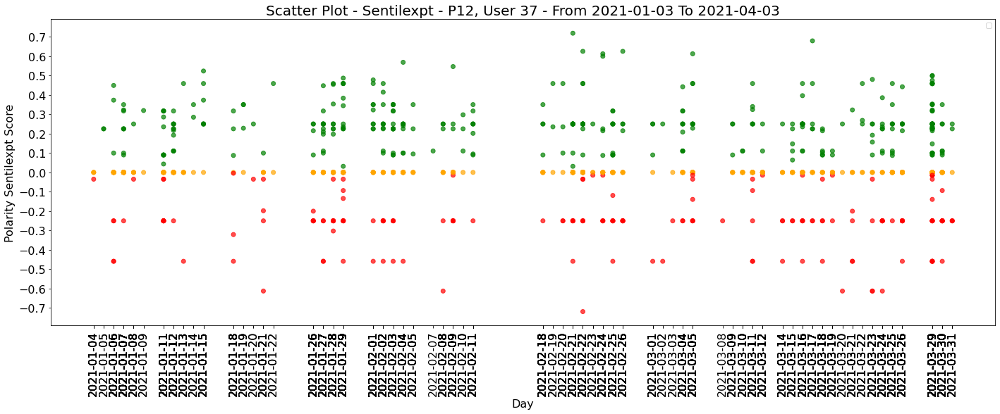

In [22]:
count = 1
for c in data:
    id_user = c
    tweets_pd = create_tweets_pd(data, id_user)
    df = pd.DataFrame(tweets_pd)
    clean_df(df)
    
    df = df.sort_values(by='created_at')
    
    df["created_at"] = pd.to_datetime(df["created_at"])
    df['date_minus_time'] = df["created_at"].apply( lambda df : datetime.datetime(year=df.year, month=df.month, day=df.day))
#     df.set_index(df["date_minus_time"],inplace=True)
    
    plot_point_chart(df, count, id_user)
    
    count += 1

In [23]:
tweets_pd = create_tweets_pd(data, id_user)
df = pd.DataFrame(tweets_pd)
df.head()

,text,created_at,id_user,vader_sentiment_analysis_score,vader_sentiment_analysis_polarity,oplexicon_sentiment_analysis_score,oplexicon_sentiment_analysis_polarity,sentistrength_sentiment_analysis_score,sentistrength_sentiment_analysis_polarity,sentilexpt_sentiment_analysis_score,sentilexpt_sentiment_analysis_polarity,final_score,final_polarity
0,@haggen É um dos grandes mistérios da tecnologia,2021-03-31T18:48:36,37,0.2960,pos,0.00,neu,0.00,neu,0.000,neu,0.074000,pos
1,@fazdenise inclusive quem não trampa lá hahaha,2021-03-31T18:47:57,37,0.3400,pos,0.00,neu,0.00,neu,-0.250,neg,0.022500,pos
2,@DouglasAmarelo Sim! O Spotify consegue fazer ...,2021-03-31T18:47:31,37,0.6360,pos,0.25,pos,0.00,neu,0.250,pos,0.284000,pos
3,StackOverflow ficou fora do ar e fiquei me per...,2021-03-31T16:17:26,37,-0.2263,neg,0.00,neu,-0.25,neg,-0.250,neg,-0.181575,neg
4,@Willian_justen @ludevsz e nada melhor pra est...,2021-03-31T12:23:38,37,0.4404,pos,0.35,pos,0.35,pos,0.225,pos,0.341350,pos


In [24]:
def plot_point_chart_pos_neg(df, count, id_user):

    first_date = df.index[0]
    
    for i in range(1,13):
        
        fig, ax = plt.subplots(figsize=(24, 8))

        end_date = first_date + relativedelta(months=+3)
        mask = (df.index >= first_date) & (df.index < end_date)
        new_df = df.loc[mask]
        
        x_ticks = new_df.index

        plt.xticks(x_ticks, rotation='vertical', fontsize=16)
        plt.yticks(np.arange(-1.0, 1.1, 0.1), fontsize=16)
        plt.xlabel('Day', fontsize=16)
        plt.ylabel('Polarity Score Mean', fontsize=16)

        date_form = DateFormatter("%Y-%m-%d")
        ax.xaxis.set_major_formatter(date_form)
    
        x = new_df.index
        y1 = new_df['sentilexpt_score_pos']
        y2 = new_df['sentilexpt_score_neg']
        y3 = new_df['mean']

        plt.title('Scatter Plot - Polarity Means - Sentilexpt - P{}, User {} - From {} To {}'.format(count, id_user, first_date.strftime("%Y-%m-%d"), end_date.strftime("%Y-%m-%d")), fontsize=20)
        
        plt.rcParams.update({
            "savefig.facecolor": (1.0, 1.0, 1.0)
        })
        
        plt.axhline(y=0.0, color='orange', linestyle='-', alpha=0.7, linewidth=4)
        
#         # plotting the line 1 points 
#         plt.scatter(new_df.index, new_df['final_score_pos'], label = "pos", marker='o', color = 'green')

#         # plotting the line 2 points 
#         plt.scatter(new_df.index, new_df['final_score_neg'], label = "neg", marker='o', color = 'red')
        
        
        # plotting the line 1 points 
        plt.plot(new_df.index, new_df['sentilexpt_score_pos'], label = "pos", marker='o', markerfacecolor='none', color = 'green')

        # plotting the line 2 points 
        plt.plot(new_df.index, new_df['sentilexpt_score_neg'], label = "neg", marker='o', markerfacecolor='none', color = 'red')
        
        # plotting the line 3 points 
        plt.plot(new_df.index, new_df['mean'], label = "mean", marker='o', markerfacecolor='none', color = 'gray', linestyle='--')
        
        plt.legend()
        
#         plt.savefig('images/scatter_pol_means_P{}_U{}_{}_{}.pdf'.format(count, id_user, first_date.strftime("%Y-%m-%d"), end_date.strftime("%Y-%m-%d")),bbox_inches='tight',transparent=False)
        
        plt.show()
        
        first_date = end_date

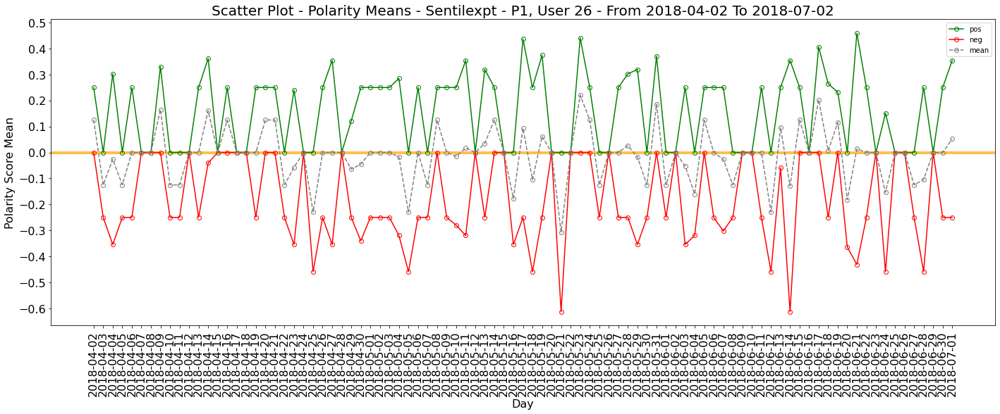

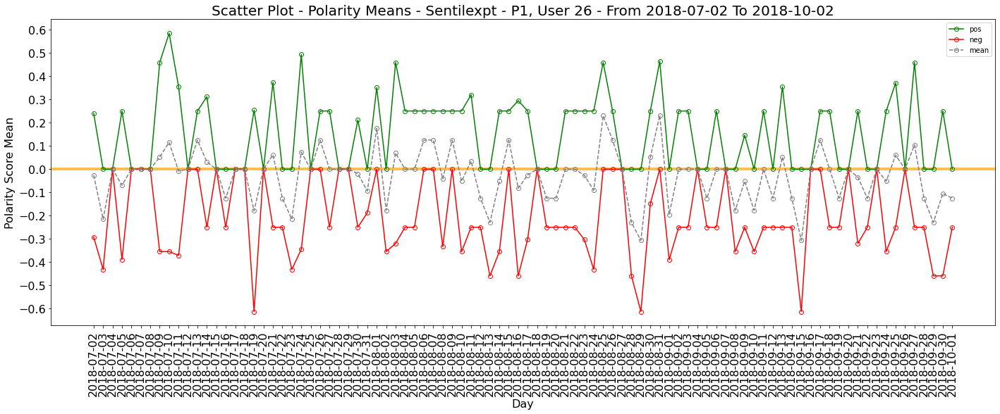

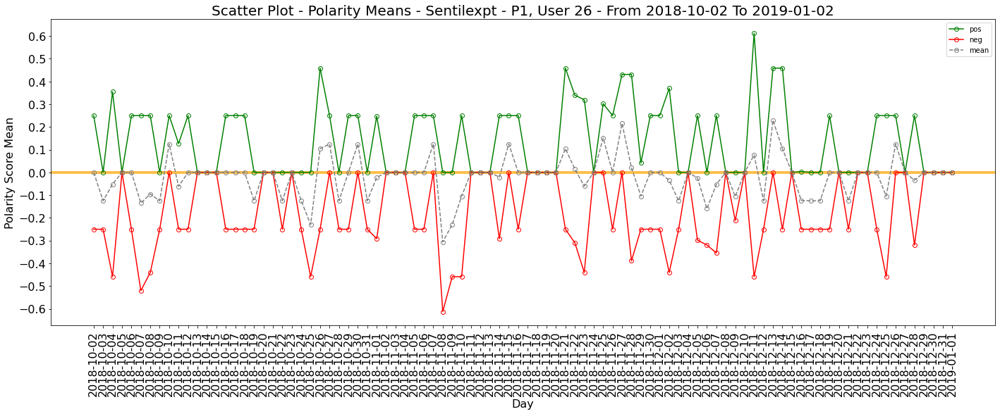

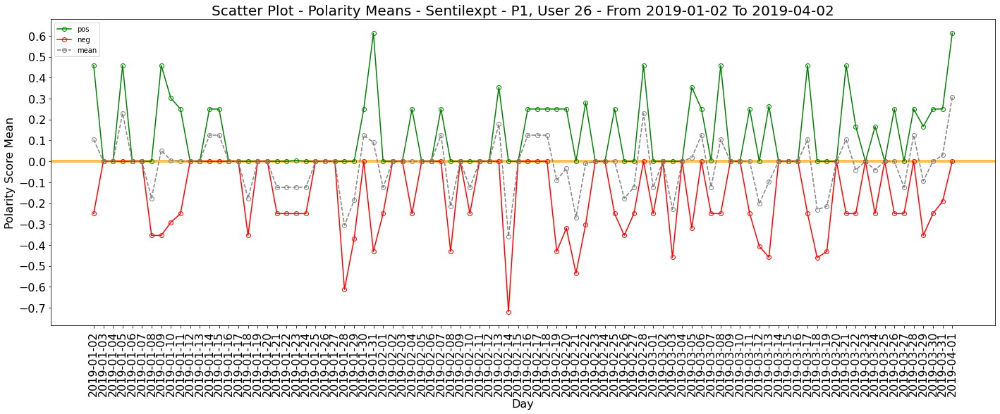

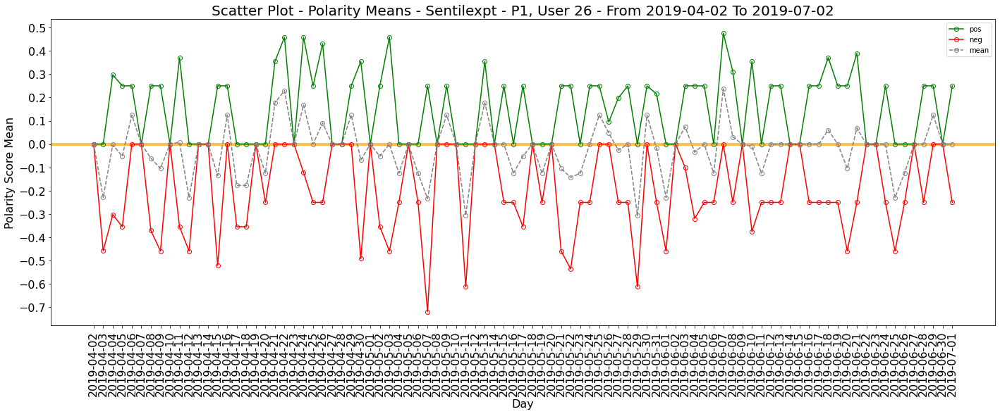

...

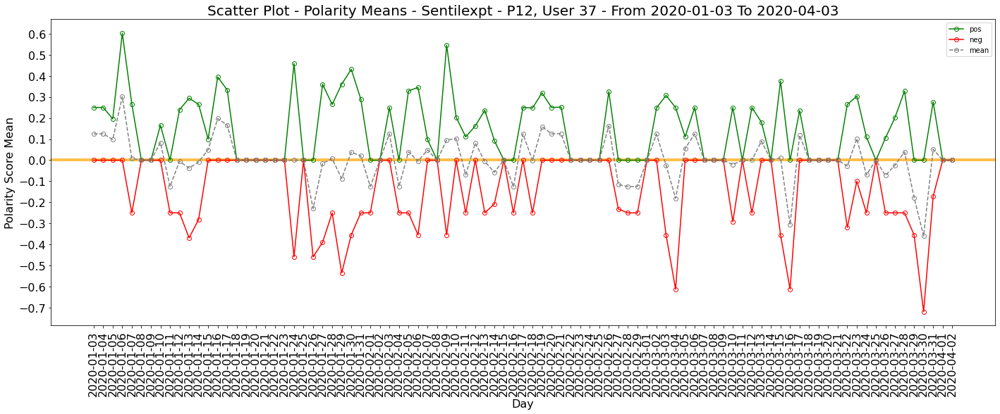

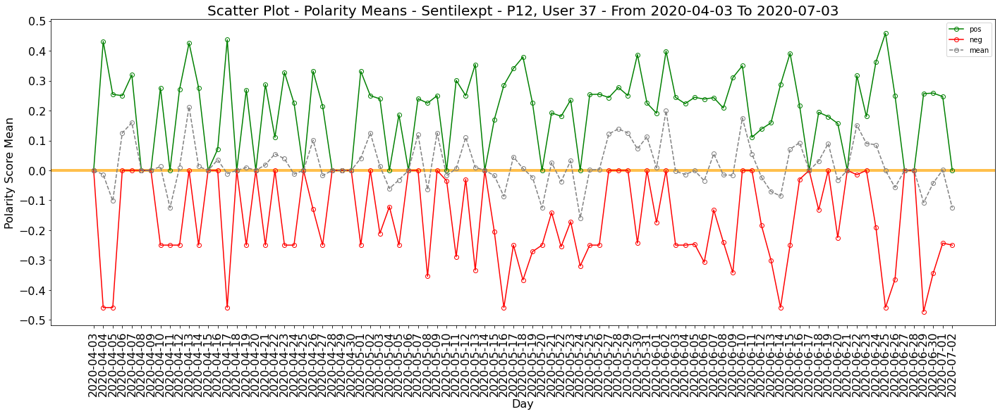

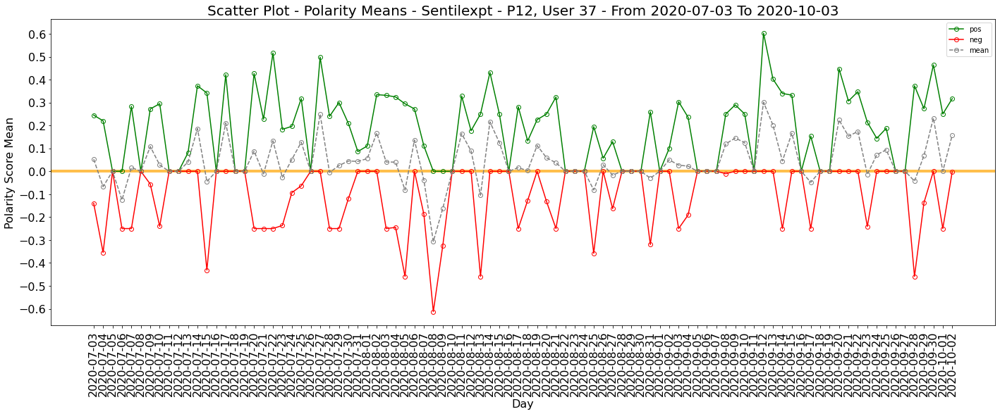

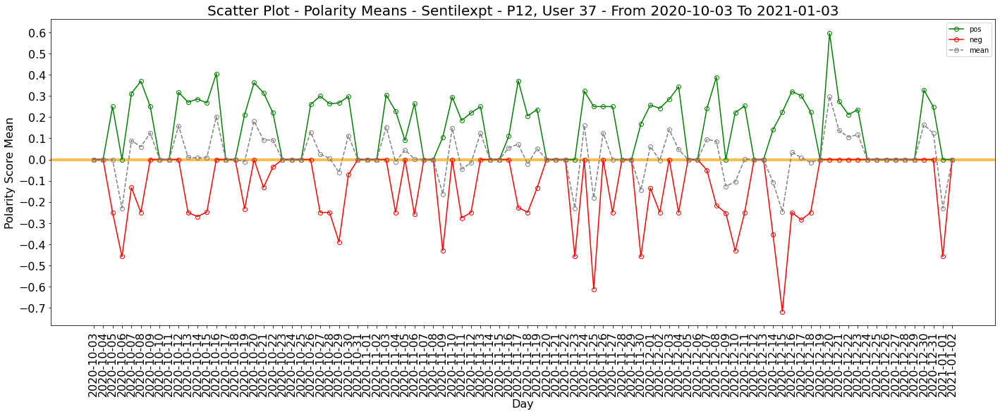

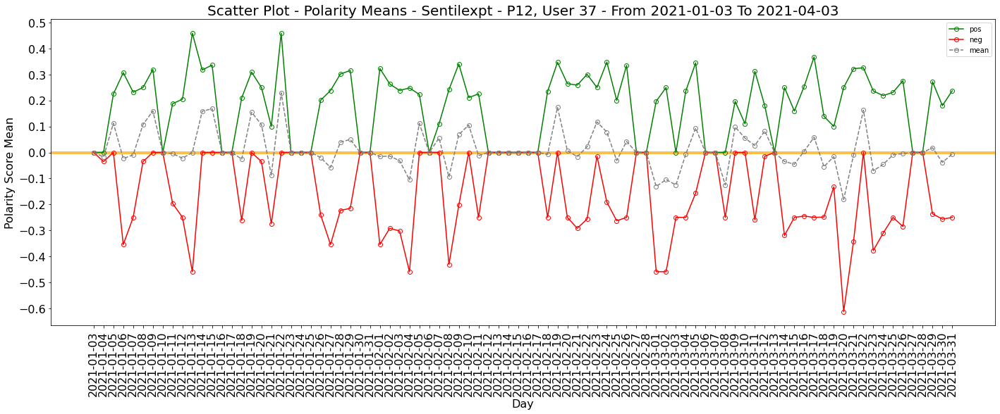

In [25]:
count = 1
for c in data:
    id_user = c
    tweets_pd = create_tweets_pd(data, id_user)
    df = pd.DataFrame(tweets_pd)
    clean_df(df)
    
    df = df.sort_values(by='created_at')
    
    df["created_at"] = pd.to_datetime(df["created_at"])
    df['date_minus_time'] = df["created_at"].apply( lambda df : datetime.datetime(year=df.year, month=df.month, day=df.day))
    df.set_index(df["date_minus_time"],inplace=True)
    
    df_pos = df.query(alg_to_analyze[1] + " == 'pos'")
    df_pos = pd.DataFrame(df_pos[alg_to_analyze[0]].resample('D').mean())
    
    df_neg = df.query(alg_to_analyze[1] + " == 'neg'")
    df_neg = pd.DataFrame(df_neg[alg_to_analyze[0]].resample('D').mean())
    
    df_final = pd.merge(df_pos, df_neg, how="outer", on=["date_minus_time"])
    df_final = df_final.fillna(0)
    df_final.columns = ['sentilexpt_score_pos', 'sentilexpt_score_neg']
    
    df_final['mean'] = df_final.iloc[:, [0,1]].mean(axis=1)
    
    plot_point_chart_pos_neg(df_final, count, id_user)
    
    count += 1

In [26]:
# Function to calculate correlation coefficient between two arrays
def corr(x, y, **kwargs):
    
    # Calculate the value
    coef = np.corrcoef(x, y)[0][1]
    # Make the label
    label = r'$\rho$ = ' + str(round(coef, 2))
    
    # Add the label to the plot
    ax = plt.gca()
    ax.annotate(label, xy = (0.2, 0.95), size = 20, xycoords = ax.transAxes)

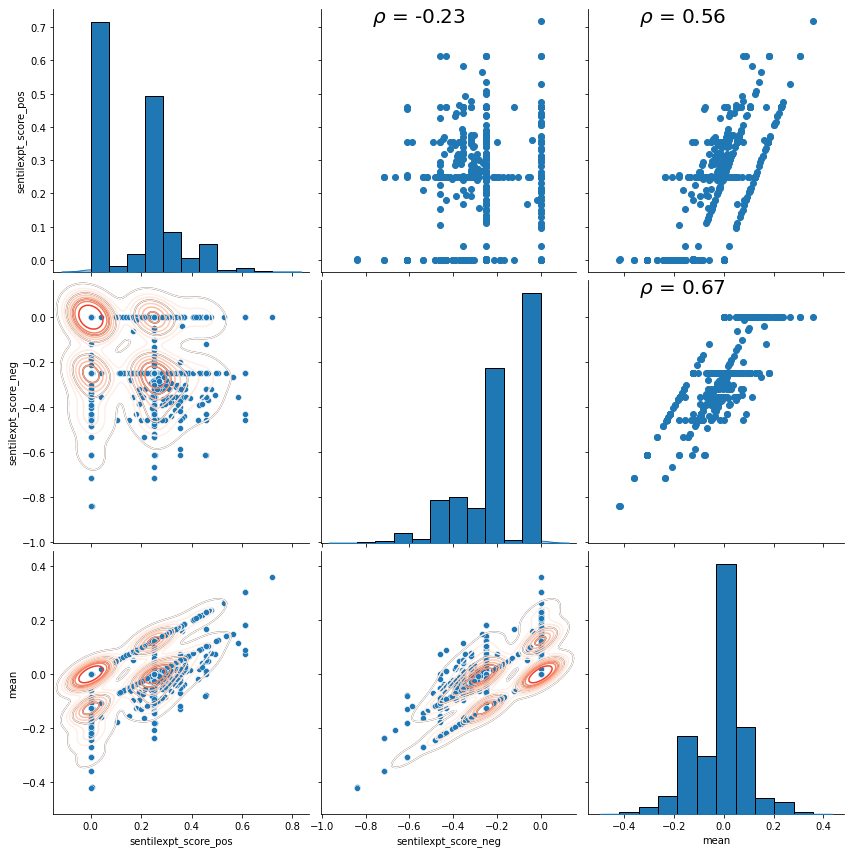

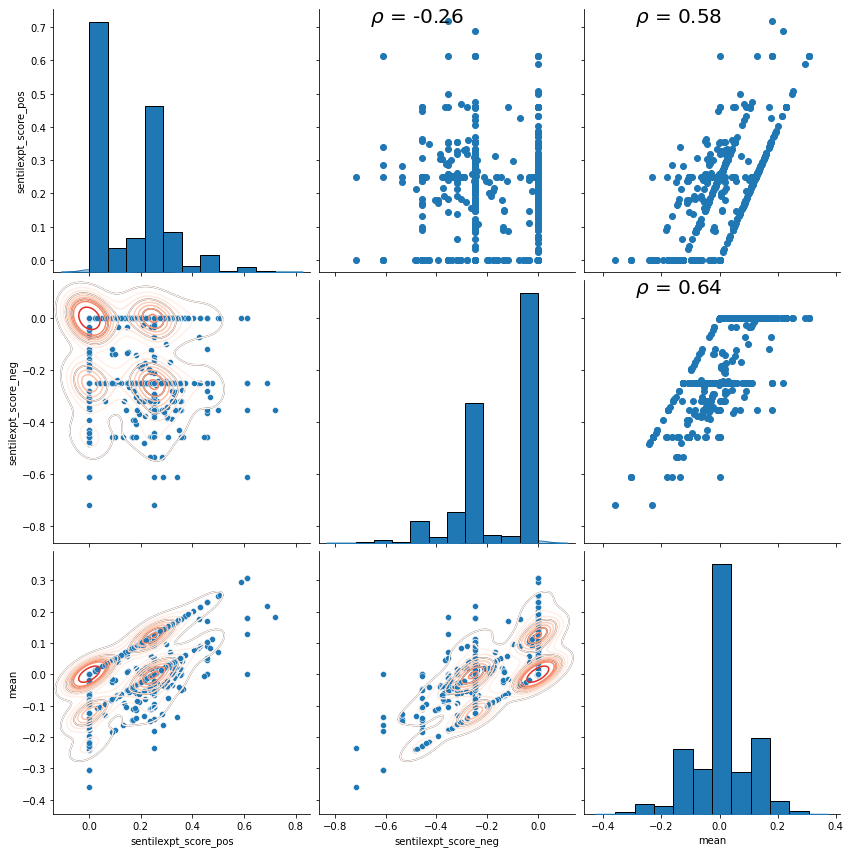

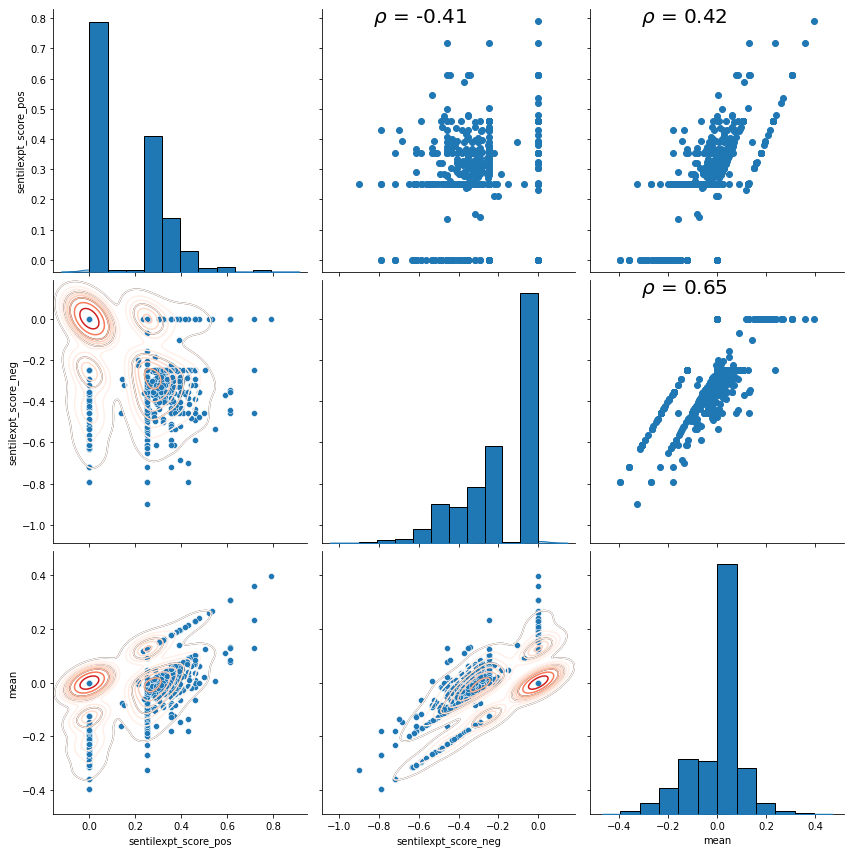

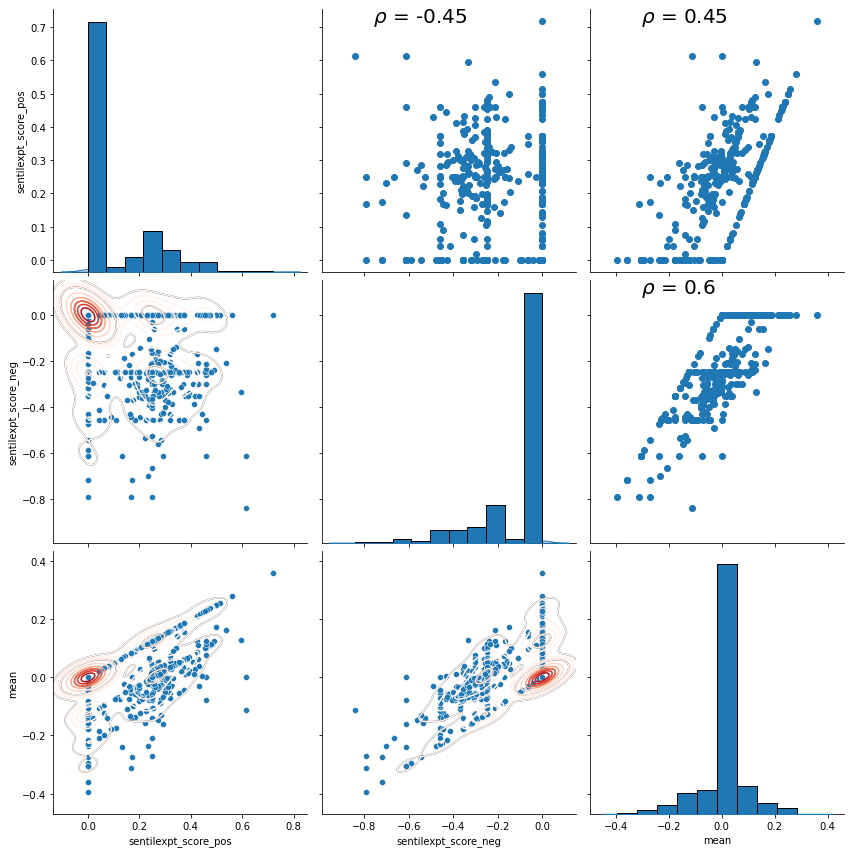

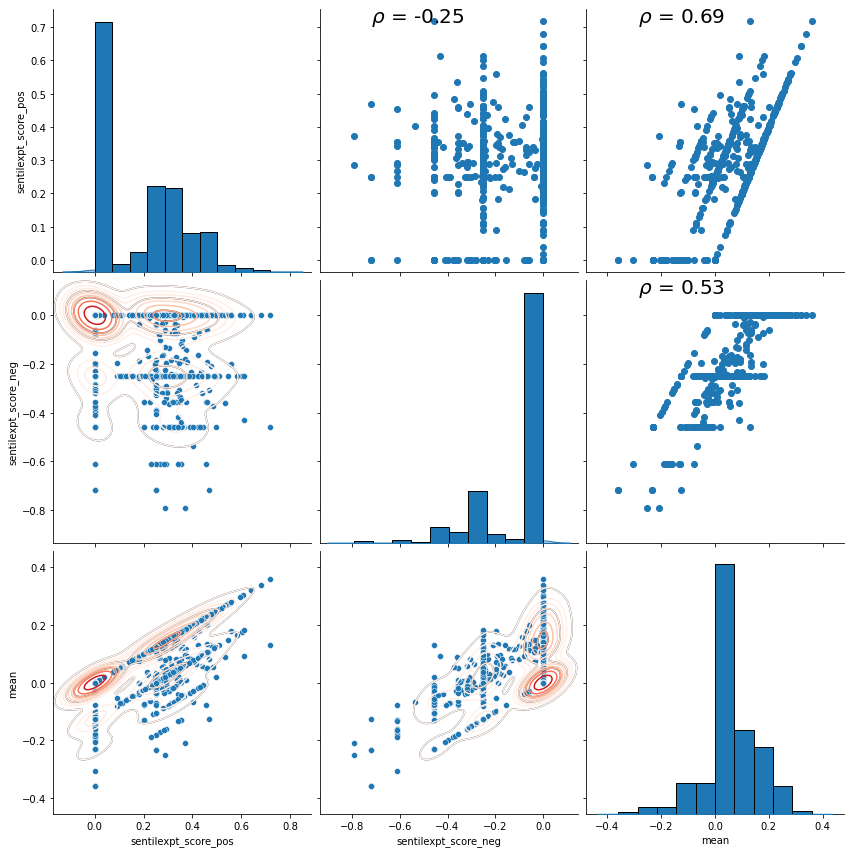

...

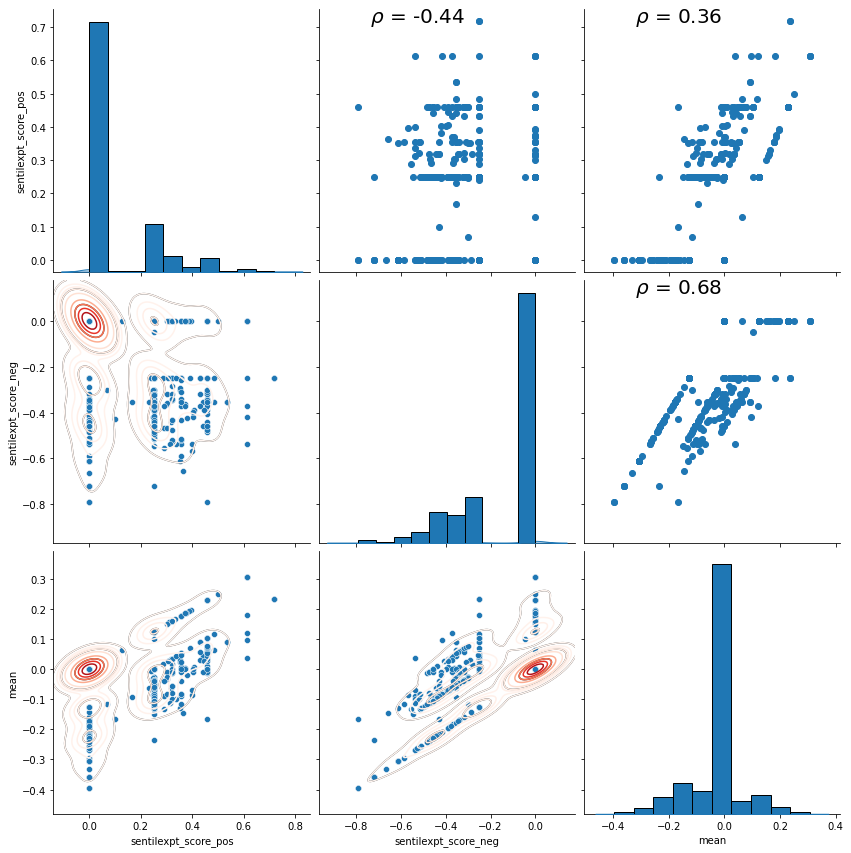

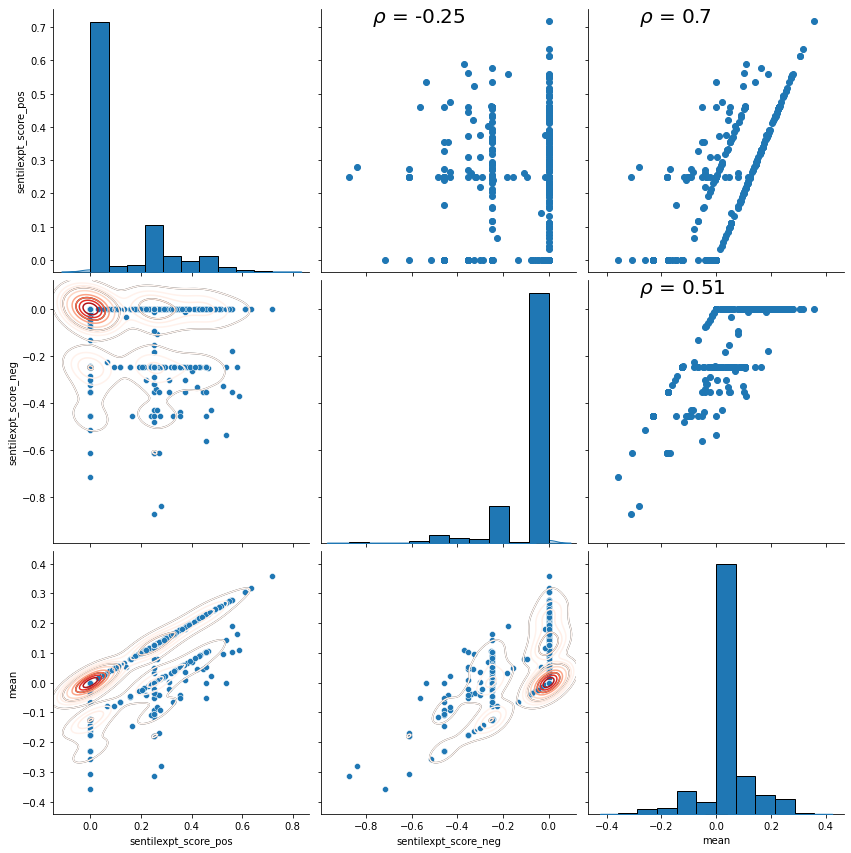

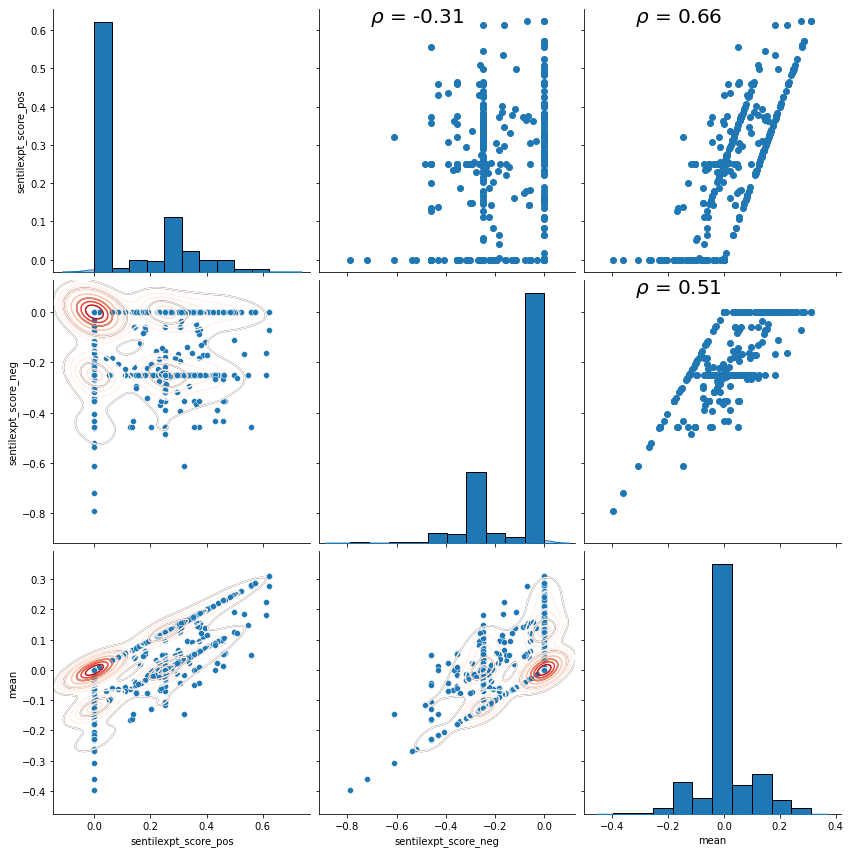

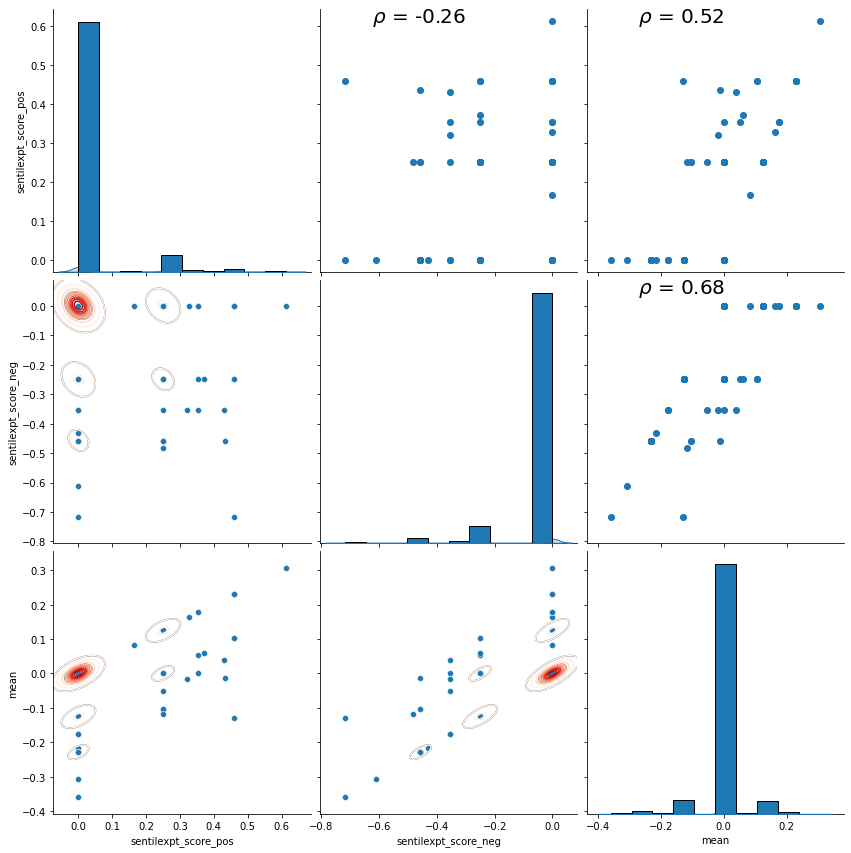

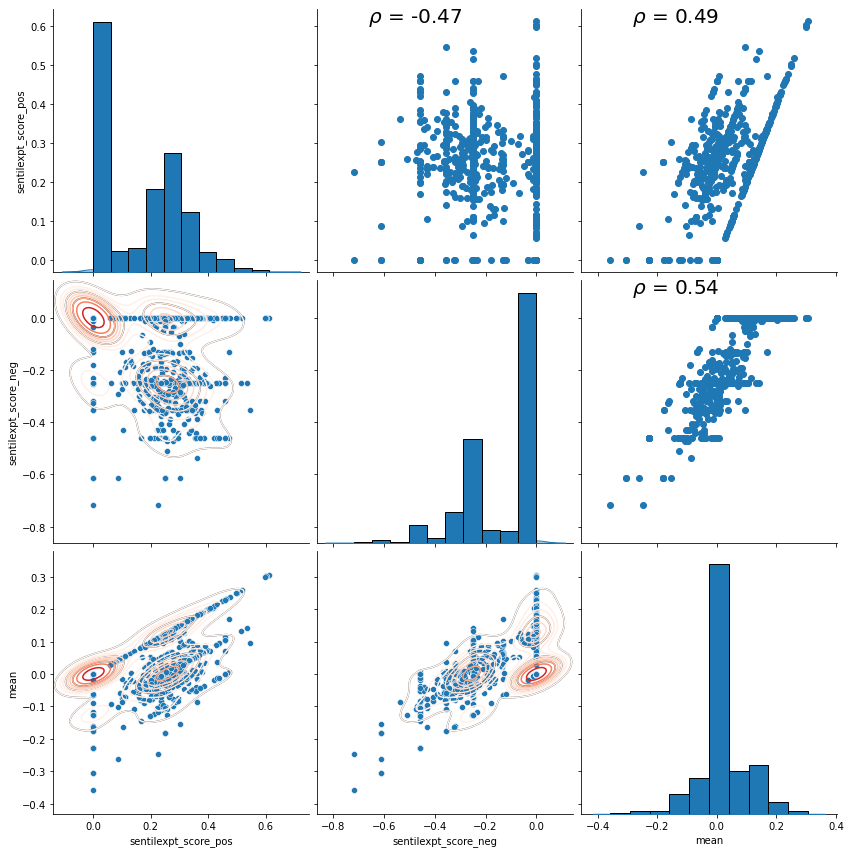

In [27]:
count = 1
for c in data:
    id_user = c
    tweets_pd = create_tweets_pd(data, id_user)
    df = pd.DataFrame(tweets_pd)
    
    clean_df(df)

    df = df.sort_values(by='created_at')

    df["created_at"] = pd.to_datetime(df["created_at"])
    df['date_minus_time'] = df["created_at"].apply( lambda df : datetime.datetime(year=df.year, month=df.month, day=df.day))
    df.set_index(df["date_minus_time"],inplace=True)

    df_pos = df.query(alg_to_analyze[1] + " == 'pos'")
    df_pos = pd.DataFrame(df_pos[alg_to_analyze[0]].resample('D').mean())

    df_neg = df.query(alg_to_analyze[1] + " == 'neg'")
    df_neg = pd.DataFrame(df_neg[alg_to_analyze[0]].resample('D').mean())

    df_final = pd.merge(df_pos, df_neg, how="outer", on=["date_minus_time"])
    df_final = df_final.fillna(0)
    df_final.columns = ['sentilexpt_score_pos', 'sentilexpt_score_neg']

    df_final['mean'] = df_final.iloc[:, [0,1]].mean(axis=1)

    g = sns.pairplot(df_final, diag_kind="kde", height=4)
    g.map_lower(sns.kdeplot, levels=4, color=".2")

    # Map the plots to the locations
    g = g.map_upper(plt.scatter)
    g = g.map_upper(corr)
    g = g.map_lower(sns.kdeplot, cmap = 'Reds')
    g = g.map_diag(plt.hist, bins = 10, edgecolor =  'k');
    
    count += 1

In [28]:
df_final

,sentilexpt_score_pos,sentilexpt_score_neg,mean
date_minus_time,,,
2018-04-03,0.385450,-0.250000,0.067725
2018-04-04,0.304250,0.000000,0.152125
2018-04-05,0.317333,-0.250000,0.033667
2018-04-06,0.110500,-0.250000,-0.069750
2018-04-07,0.000000,0.000000,0.000000
...,...,...,...
2021-03-27,0.000000,0.000000,0.000000
2021-03-28,0.000000,0.000000,0.000000
2021-03-29,0.272471,-0.235946,0.018263


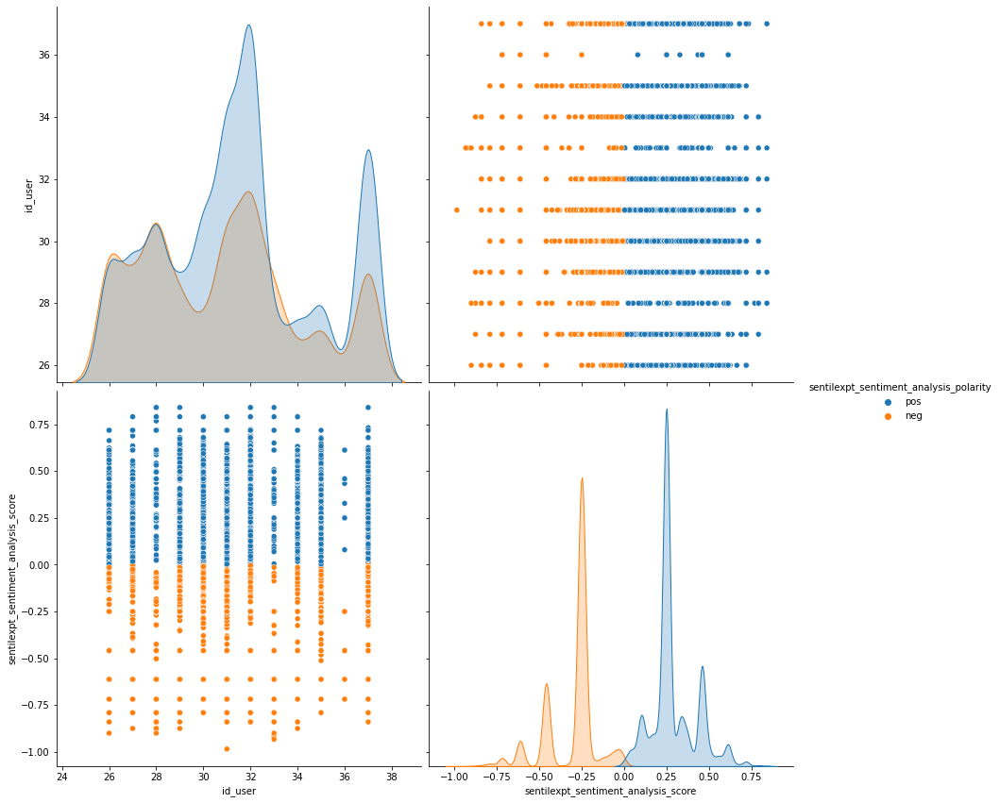

In [29]:
tweets = [data[d]['tweets'] for d in data]

final_tweets = []
for i in tweets:
    final_tweets.extend(i)

df = pd.DataFrame(final_tweets)

del df[0]
del df[1]
del df[4]
del df[5]
del df[6]
del df[18]

df.columns = ["text", "created_at", "id_user", "vader_sentiment_analysis_score", "vader_sentiment_analysis_polarity",
                         "oplexicon_sentiment_analysis_score", "oplexicon_sentiment_analysis_polarity",
                         "sentistrength_sentiment_analysis_score", "sentistrength_sentiment_analysis_polarity",
                         "sentilexpt_sentiment_analysis_score", "sentilexpt_sentiment_analysis_polarity",
                         "final_score", "final_polarity"]

clean_df(df)

df = df.sort_values(by='created_at')

# print(df)

df["created_at"] = pd.to_datetime(df["created_at"])
df['date_minus_time'] = df["created_at"].apply( lambda df : datetime.datetime(year=df.year, month=df.month, day=df.day))
# df.set_index(df["date_minus_time"],inplace=True)

df_final = df.query(alg_to_analyze[1] + " == 'pos' or " + alg_to_analyze[1] + " == 'neg'")

# df_pos = pd.DataFrame(df_pos['final_score'].resample('D').mean())
# df_pos['final_score_mean'] = df_pos['final_score'].resample('D').mean()

# print(df_pos)


# df_neg = df.query("final_polarity == 'neg'")
# df_neg = pd.DataFrame(df_neg['final_score'].resample('D').mean())

# df_final = pd.merge(df_pos, df_neg, how="outer", on=["date_minus_time"])
# df_final = df_final.fillna(0)
# df_final.columns = ['final_score_pos', 'final_score_neg']

# df_final['mean'] = df_final.iloc[:, [0,1]].mean(axis=1)

# df_final.head()

sns.pairplot(df_final, diag_kind="kde", height=6, hue=alg_to_analyze[1])

Text(0.5, 1.02, 'PairPlot')

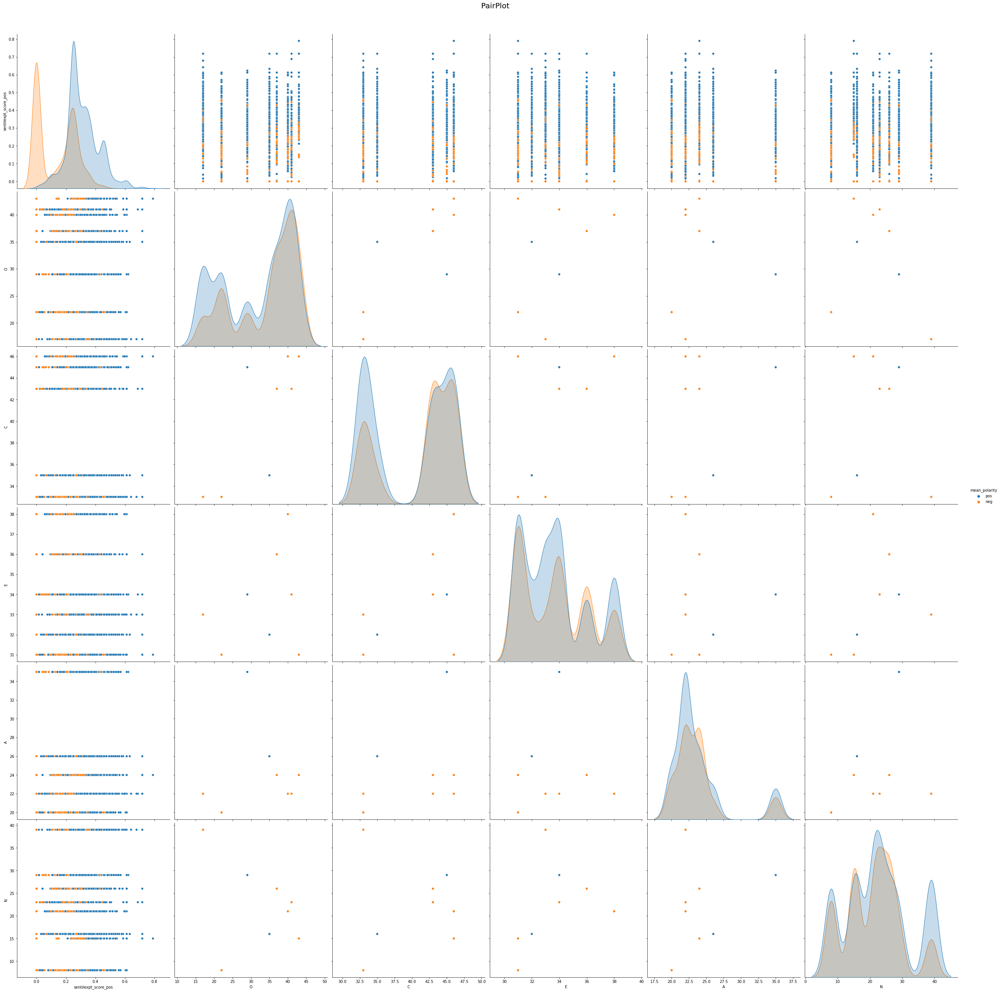

In [30]:
frames = []

count = 1
for c in data:
    id_user = c
    
    df_bf = pd.DataFrame(data[id_user]['bigfive'])
    
    if df_bf.empty == False:
        tweets_pd = create_tweets_pd(data, id_user)
        df = pd.DataFrame(tweets_pd)

        clean_df(df)

        df = df.sort_values(by='created_at')

        df["created_at"] = pd.to_datetime(df["created_at"])
        df['date_minus_time'] = df["created_at"].apply( lambda df : datetime.datetime(year=df.year, month=df.month, day=df.day))
        df.set_index(df["date_minus_time"],inplace=True)

        df_pos = df.query(alg_to_analyze[1] + " == 'pos'")

        df_pos = pd.DataFrame(df_pos[alg_to_analyze[0]].resample('D').mean())

        df_neg = df.query(alg_to_analyze[1] + " == 'neg'")
        df_neg = pd.DataFrame(df_neg[alg_to_analyze[0]].resample('D').mean())

        df_final = pd.merge(df_pos, df_neg, how="outer", on=["date_minus_time"])
        df_final = df_final.fillna(0)
        df_final.columns = ['sentilexpt_score_pos', 'sentilexpt_score_neg']

        df_final['mean'] = df_final.iloc[:, [0,1]].mean(axis=1)
        df_final.loc[df_final['mean'] > 0, ['mean_polarity']] = 'pos'
        df_final.loc[df_final['mean'] < 0, ['mean_polarity']] = 'neg'

    #     df_final = df_final.drop(df_final["mean_polarity"])
        df_final = df_final.dropna(how = 'any')

        df_final['id_user'] = id_user
        
        df_final['O'] = int(bigfive[id_user]['O'])
        df_final['C'] = int(bigfive[id_user]['C'])
        df_final['E'] = int(bigfive[id_user]['E'])
        df_final['A'] = int(bigfive[id_user]['A'])
        df_final['N'] = int(bigfive[id_user]['N'])

    #     g = sns.pairplot(df_final, diag_kind="kde", height=4)

        count += 1
        
        frames.append(df_final)

#         g = sns.pairplot(df_final, diag_kind="kde", height=6, hue="mean_polarity")
#         g.fig.suptitle("PairPlot - P{} - U{}".format(count, id_user), fontsize=20, y=1.02) # y= some height>1
    #     g.map_lower(sns.kdeplot, levels=4, color=".2")

    #     # Map the plots to the locations
    #     g = g.map_upper(plt.scatter)
    #     g = g.map_upper(corr)
    #     g = g.map_lower(sns.kdeplot)
    #     g = g.map_diag(plt.hist, bins = 10, edgecolor =  'k');

    
result = pd.concat(frames)

# print(result)

# print(result.loc[result['mean_polarity'] == 'neg'])

g = sns.pairplot(result, diag_kind="kde", height=6, hue="mean_polarity", vars=['sentilexpt_score_pos', 
                                                                            'O',
                                                                            'C',
                                                                            'E',
                                                                            'A',
                                                                            'N'
                                                                              ])
g.fig.suptitle("PairPlot", fontsize=20, y=1.02) # y= some height>1

In [31]:
ids = result['id_user'].unique()
bf = ['O', 'C', 'E', 'A', 'N']

for b in bf:
    df_chart[b] = 0

for i in ids:
    for b in bf:
        df_chart.loc[df_chart['id_user'] == i, b] = int(bigfive[i][b])
        
        
df_chart.head()

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean_all,mean_posneg,O,C,E,A,N
0,26,1200,2476,1363,23.814249,49.136733,27.049018,-0.016055,-0.031565,37,43,36,24,26
1,27,1158,2406,985,25.456144,52.890745,21.653111,0.004249,0.009018,41,43,34,22,23
2,28,1538,2742,1653,25.922805,46.216080,27.861116,-0.015823,-0.029420,43,46,31,24,15
3,29,907,1590,852,27.082711,47.476859,25.440430,-0.002688,-0.005118,0,0,0,0,0
4,30,1547,1084,541,48.770492,34.174023,17.055485,0.111872,0.169951,17,33,33,22,39


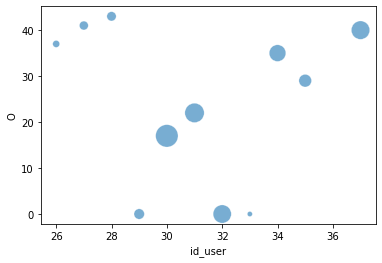

In [32]:

sns.scatterplot(data=df_chart, x="id_user", y="O", 
                size='por_pos', 
                legend=False, 
                sizes=(0, 500),
                cmap="Accent",
                alpha=0.6)


plt.show()

In [33]:
df_chart = df_chart.drop(df_chart[df_chart['O'] == 0].index)
df_chart

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean_all,mean_posneg,O,C,E,A,N
0,26,1200,2476,1363,23.814249,49.136733,27.049018,-0.016055,-0.031565,37,43,36,24,26
1,27,1158,2406,985,25.456144,52.890745,21.653111,0.004249,0.009018,41,43,34,22,23
2,28,1538,2742,1653,25.922805,46.216080,27.861116,-0.015823,-0.029420,43,46,31,24,15
4,30,1547,1084,541,48.770492,34.174023,17.055485,0.111872,0.169951,17,33,33,22,39
5,31,2501,1948,1547,41.711141,32.488326,25.800534,0.039641,0.058718,22,33,31,20,8
8,34,562,664,319,36.375405,42.977346,20.647249,0.051674,0.090621,35,35,32,26,16
9,35,777,1262,556,29.942197,48.631985,21.425819,0.034614,0.067384,29,45,34,35,29
11,37,2566,2596,1294,39.745973,40.210657,20.043371,0.052329,0.087523,40,46,38,22,21


In [34]:
pos_list = df_chart['pos'].tolist()
o_list = df_chart['O'].tolist()
c_list = df_chart['C'].tolist()
e_list = df_chart['E'].tolist()
a_list = df_chart['A'].tolist()
n_list = df_chart['N'].tolist()

print('pos: mean=%.3f stdv=%.3f' % (np.mean(pos_list), np.std(pos_list)))
print('o: mean=%.3f stdv=%.3f' % (np.mean(o_list), np.std(o_list)))
print('c: mean=%.3f stdv=%.3f' % (np.mean(c_list), np.std(c_list)))
print('e: mean=%.3f stdv=%.3f' % (np.mean(e_list), np.std(e_list)))
print('a: mean=%.3f stdv=%.3f' % (np.mean(a_list), np.std(a_list)))
print('n: mean=%.3f stdv=%.3f' % (np.mean(n_list), np.std(n_list)))

r = np.corrcoef(pos_list, o_list)
print('r x o', r)
r = np.corrcoef(pos_list, c_list)
print('r x c', r)
r = np.corrcoef(pos_list, e_list)
print('r x e', r)
r = np.corrcoef(pos_list, a_list)
print('r x a', r)
r = np.corrcoef(pos_list, n_list)
print('r x n', r)

print('pearsonr pos x o: ',scipy.stats.pearsonr(pos_list, o_list))    # Pearson's r
print('pearsonr pos x c: ',scipy.stats.pearsonr(pos_list, c_list))    # Pearson's r
print('pearsonr pos x e: ',scipy.stats.pearsonr(pos_list, e_list))    # Pearson's r
print('pearsonr pos x a: ',scipy.stats.pearsonr(pos_list, a_list))    # Pearson's r
print('pearsonr pos x n: ',scipy.stats.pearsonr(pos_list, n_list))    # Pearson's r
print('spearmanr pos x o: ',scipy.stats.spearmanr(pos_list, o_list))   # Spearman's rho
print('spearmanr pos x c: ',scipy.stats.spearmanr(pos_list, c_list))   # Spearman's rho
print('spearmanr pos x e: ',scipy.stats.spearmanr(pos_list, e_list))   # Spearman's rho
print('spearmanr pos x a: ',scipy.stats.spearmanr(pos_list, a_list))   # Spearman's rho
print('spearmanr pos x n: ',scipy.stats.spearmanr(pos_list, n_list))   # Spearman's rho
print('kendalltau pos x o: ',scipy.stats.kendalltau(pos_list, o_list))  # Kendall's tau
print('kendalltau pos x c: ',scipy.stats.kendalltau(pos_list, c_list))  # Kendall's tau
print('kendalltau pos x e: ',scipy.stats.kendalltau(pos_list, e_list))  # Kendall's tau
print('kendalltau pos x a: ',scipy.stats.kendalltau(pos_list, a_list))  # Kendall's tau
print('kendalltau pos x n: ',scipy.stats.kendalltau(pos_list, n_list))  # Kendall's tau

pos: mean=1481.125 stdv=684.534
o: mean=33.000 stdv=8.846
c: mean=40.500 stdv=5.431
e: mean=33.625 stdv=2.288
a: mean=24.375 stdv=4.357
n: mean=22.125 stdv=8.922
r x o [[ 1.         -0.14121872]
 [-0.14121872  1.        ]]
r x c [[ 1.         -0.05001046]
 [-0.05001046  1.        ]]
r x e [[1.         0.18512002]
 [0.18512002 1.        ]]
r x a [[ 1.         -0.64199166]
 [-0.64199166  1.        ]]
r x n [[ 1.         -0.31728679]
 [-0.31728679  1.        ]]
pearsonr pos x o:  (-0.14121871706839773, 0.7387142015723972)
pearsonr pos x c:  (-0.05001045557722522, 0.9063866265241601)
pearsonr pos x e:  (0.18512002471385092, 0.6607483729296251)
pearsonr pos x a:  (-0.6419916647370906, 0.08611860211822138)
pearsonr pos x n:  (-0.317286786353661, 0.4438083662174781)
spearmanr pos x o:  SpearmanrResult(correlation=-0.07142857142857144, pvalue=0.8665262706759088)
spearmanr pos x c:  SpearmanrResult(correlation=0.0363696483726654, pvalue=0.9318670204387731)
spearmanr pos x e:  SpearmanrResult(co

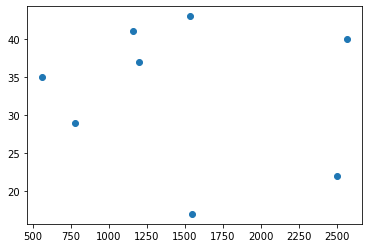

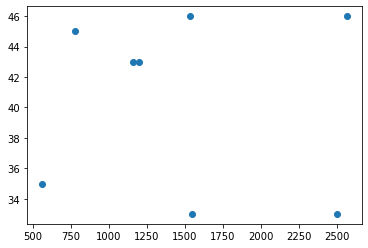

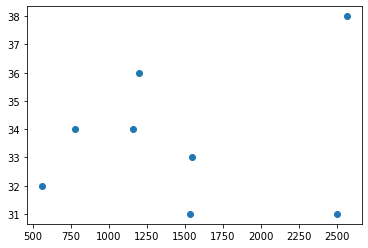

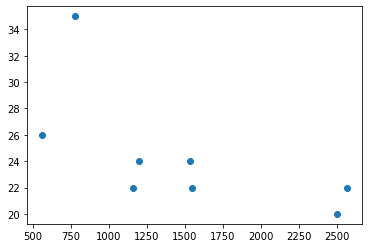

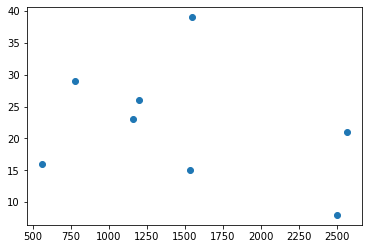

In [35]:
plt.scatter(pos_list, o_list)
plt.show()

plt.scatter(pos_list, c_list)
plt.show()

plt.scatter(pos_list, e_list)
plt.show()

plt.scatter(pos_list, a_list)
plt.show()

plt.scatter(pos_list, n_list)
plt.show()

In [36]:
slope, intercept, r, p, stderr = scipy.stats.linregress(pos_list, o_list)
o_line = f'Regression line: y={intercept:.2f}+{slope:.2f}x, r={r:.2f}'
slope, intercept, r, p, stderr = scipy.stats.linregress(pos_list, c_list)
c_line = f'Regression line: y={intercept:.2f}+{slope:.2f}x, r={r:.2f}'
slope, intercept, r, p, stderr = scipy.stats.linregress(pos_list, e_list)
e_line = f'Regression line: y={intercept:.2f}+{slope:.2f}x, r={r:.2f}'
slope, intercept, r, p, stderr = scipy.stats.linregress(pos_list, a_list)
a_line = f'Regression line: y={intercept:.2f}+{slope:.2f}x, r={r:.2f}'
slope, intercept, r, p, stderr = scipy.stats.linregress(pos_list, n_list)
n_line = f'Regression line: y={intercept:.2f}+{slope:.2f}x, r={r:.2f}'


print('o x pos: ',o_line)
print('c x pos: ',c_line)
print('e x pos: ',e_line)
print('a x pos: ',a_line)
print('n x pos: ',n_line)

o x pos:  Regression line: y=35.70+-0.00x, r=-0.14
c x pos:  Regression line: y=41.09+-0.00x, r=-0.05
e x pos:  Regression line: y=32.71+0.00x, r=0.19
a x pos:  Regression line: y=30.43+-0.00x, r=-0.64
n x pos:  Regression line: y=28.25+-0.00x, r=-0.32


In [38]:
pg.corr(x=df_chart['pos'], y=df_chart['O'])

,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,8,-0.141219,"[-0.77, 0.63]",0.019943,-0.37208,0.738714,0.451,0.062144


In [39]:
pg.pairwise_corr(df_chart).sort_values(by=['p-unc'])[['X', 'Y', 'n', 'r', 'p-unc']].head()

,X,Y,n,r,p-unc
70,mean_all,mean_posneg,8,0.994108,5.090291e-07
48,por_pos,mean_all,8,0.930520,7.954534e-04
46,por_pos,por_neu,8,-0.914398,1.469194e-03
49,por_pos,mean_posneg,8,0.904588,2.019033e-03
25,neu,neg,8,0.881916,3.760433e-03


In [40]:
corr_pos = pg.pairwise_corr(df_chart, columns=[['pos'],['O', 'C', 'E', 'A', 'N']], method='spearman')
corr_pos

,X,Y,method,tail,n,r,CI95%,r2,adj_r2,z,p-unc,power
0,pos,O,spearman,two-sided,8,-0.071429,"[-0.74, 0.67]",0.005102,-0.392857,-0.071550,0.866526,0.052264
1,pos,C,spearman,two-sided,8,0.036370,"[-0.69, 0.72]",0.001323,-0.398148,0.036386,0.931867,0.049796
2,pos,E,spearman,two-sided,8,0.060245,"[-0.67, 0.73]",0.003630,-0.394919,0.060318,0.887313,0.051300
3,pos,A,spearman,two-sided,8,-0.773370,"[-0.96, -0.15]",0.598101,0.437342,-1.028659,0.024378,0.675281
4,pos,N,spearman,two-sided,8,-0.214286,"[-0.8, 0.58]",0.045918,-0.335714,-0.217659,0.610344,0.080163


In [41]:
corr_neg = pg.pairwise_corr(df_chart, columns=[['neg'],['O', 'C', 'E', 'A', 'N']], method='spearman')
corr_neg

,X,Y,method,tail,n,r,CI95%,r2,adj_r2,z,p-unc,power
0,neg,O,spearman,two-sided,8,0.452381,"[-0.37, 0.88]",0.204649,-0.113492,0.487690,0.260405,0.210879
1,neg,C,spearman,two-sided,8,0.363696,"[-0.46, 0.85]",0.132275,-0.214815,0.381139,0.375818,0.146836
2,neg,E,spearman,two-sided,8,-0.192785,"[-0.79, 0.59]",0.037166,-0.347967,-0.195228,0.647384,0.073988
3,neg,A,spearman,two-sided,8,-0.343720,"[-0.84, 0.48]",0.118143,-0.234599,-0.358305,0.404486,0.135205
4,neg,N,spearman,two-sided,8,-0.547619,"[-0.9, 0.26]",0.299887,0.019841,-0.614974,0.160026,0.306533


In [42]:
corr_mean_pn = pg.pairwise_corr(df_chart, columns=[['mean_posneg'],['O', 'C', 'E', 'A', 'N']], method='spearman')
corr_mean_pn

,X,Y,method,tail,n,r,CI95%,r2,adj_r2,z,p-unc,power
0,mean_posneg,O,spearman,two-sided,8,-0.595238,"[-0.92, 0.19]",0.354308,0.096032,-0.685740,0.119530,0.366820
1,mean_posneg,C,spearman,two-sided,8,-0.363696,"[-0.85, 0.46]",0.132275,-0.214815,-0.381139,0.375818,0.146836
2,mean_posneg,E,spearman,two-sided,8,-0.024098,"[-0.72, 0.69]",0.000581,-0.399187,-0.024103,0.954833,0.049313
3,mean_posneg,A,spearman,two-sided,8,-0.036827,"[-0.72, 0.69]",0.001356,-0.398101,-0.036844,0.931012,0.049817
4,mean_posneg,N,spearman,two-sided,8,0.261905,"[-0.54, 0.82]",0.068594,-0.303968,0.268152,0.530923,0.096657


In [43]:
corr_mean_all = pg.pairwise_corr(df_chart, columns=[['mean_all'],['O', 'C', 'E', 'A', 'N']], method='spearman')
corr_mean_all

,X,Y,method,tail,n,r,CI95%,r2,adj_r2,z,p-unc,power
0,mean_all,O,spearman,two-sided,8,-0.571429,"[-0.91, 0.22]",0.326531,0.057143,-0.649641,0.138960,0.335554
1,mean_all,C,spearman,two-sided,8,-0.363696,"[-0.85, 0.46]",0.132275,-0.214815,-0.381139,0.375818,0.146836
2,mean_all,E,spearman,two-sided,8,0.000000,"[-0.7, 0.7]",0.000000,-0.400000,0.000000,1.000000,0.048936
3,mean_all,A,spearman,two-sided,8,-0.306893,"[-0.83, 0.51]",0.094183,-0.268143,-0.317112,0.459685,0.116132
4,mean_all,N,spearman,two-sided,8,0.142857,"[-0.62, 0.77]",0.020408,-0.371429,0.143841,0.735765,0.062459


In [44]:
df_chart.corr(method='spearman').round(4)

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean_all,mean_posneg,O,C,E,A,N
id_user,1.0000,0.1429,-0.2619,-0.3333,0.5952,-0.5000,-0.5952,0.6667,0.6667,-0.2857,0.1818,0.1084,0.1228,-0.0952
pos,0.1429,1.0000,0.4762,0.5238,0.5000,-0.6190,-0.0952,0.3333,0.0476,-0.0714,0.0364,0.0602,-0.7734,-0.2143
neu,-0.2619,0.4762,1.0000,0.8333,-0.4524,0.2619,0.5714,-0.5238,-0.6905,0.7619,0.7274,0.2169,-0.1964,-0.3095
neg,-0.3333,0.5238,0.8333,1.0000,-0.2857,0.0000,0.7857,-0.5714,-0.7619,0.4524,0.3637,-0.1928,-0.3437,-0.5476
por_pos,0.5952,0.5000,-0.4524,-0.2857,1.0000,-0.9286,-0.6667,0.9048,0.8095,-0.6905,-0.4728,-0.2892,-0.4419,-0.0476
por_neu,-0.5000,-0.6190,0.2619,0.0000,-0.9286,1.0000,0.4048,-0.7381,-0.5952,0.5952,0.4364,0.4097,0.4910,0.3095
por_neg,-0.5952,-0.0952,0.5714,0.7857,-0.6667,0.4048,1.0000,-0.9048,-0.9286,0.5000,0.2546,-0.3253,0.0859,-0.4762
mean_all,0.6667,0.3333,-0.5238,-0.5714,0.9048,-0.7381,-0.9048,1.0000,0.9524,-0.5714,-0.3637,0.0000,-0.3069,0.1429
mean_posneg,0.6667,0.0476,-0.6905,-0.7619,0.8095,-0.5952,-0.9286,0.9524,1.0000,-0.5952,-0.3637,-0.0241,-0.0368,0.2619
O,-0.2857,-0.0714,0.7619,0.4524,-0.6905,0.5952,0.5000,-0.5714,-0.5952,1.0000,0.7638,0.1687,0.1350,-0.3333


In [45]:
pg.corr(df_chart['pos'], df_chart['A']).round(4)

,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,8,-0.642,"[-0.93, 0.11]",0.4122,0.177,0.0861,1.539,0.4351


Text(0.5, 1.0, 'Correlation matrix')

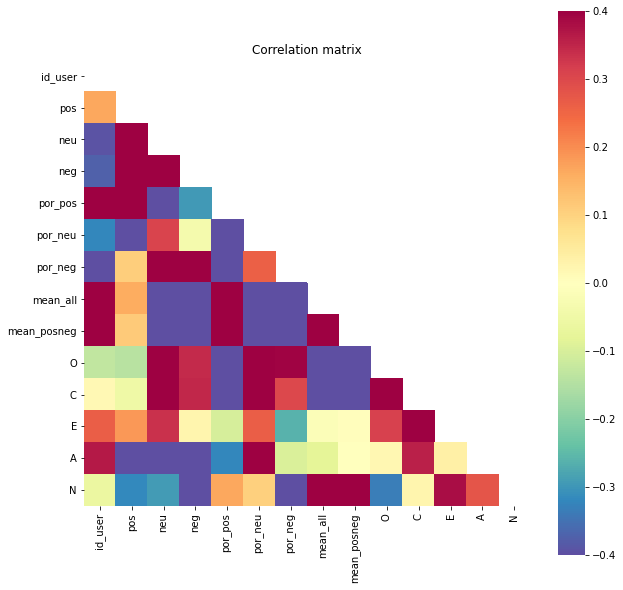

In [46]:
fig, ax = plt.subplots(figsize=(10,10))         # Sample figsize in inches

corrs = df_chart.corr()
mask = np.zeros_like(corrs)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(corrs, cmap='Spectral_r', mask=mask, square=True, vmin=-.4, vmax=.4)
plt.title('Correlation matrix')

In [47]:
df_chart.rcorr(method='spearman', upper='pval', decimals=3, padjust=None, stars=False)

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean_all,mean_posneg,O,C,E,A,N
id_user,-,0.736,0.531,0.42,0.12,0.207,0.12,0.071,0.071,0.493,0.666,0.798,0.772,0.823
pos,0.143,-,0.233,0.183,0.207,0.102,0.823,0.42,0.911,0.867,0.932,0.887,0.024,0.610
neu,-0.262,0.476,-,0.010,0.260,0.531,0.139,0.183,0.058,0.028,0.041,0.606,0.641,0.456
neg,-0.333,0.524,0.833,-,0.493,1.,0.021,0.139,0.028,0.260,0.376,0.647,0.404,0.160
por_pos,0.595,0.5,-0.452,-0.286,-,0.001,0.071,0.002,0.015,0.058,0.237,0.487,0.273,0.911
por_neu,-0.5,-0.619,0.262,0.0,-0.929,-,0.32,0.037,0.12,0.12,0.28,0.313,0.217,0.456
por_neg,-0.595,-0.095,0.571,0.786,-0.667,0.405,-,0.002,0.001,0.207,0.543,0.432,0.84,0.233
mean_all,0.667,0.333,-0.524,-0.571,0.905,-0.738,-0.905,-,0.000,0.139,0.376,1.,0.46,0.736
mean_posneg,0.667,0.048,-0.69,-0.762,0.81,-0.595,-0.929,0.952,-,0.12,0.376,0.955,0.931,0.531
O,-0.286,-0.071,0.762,0.452,-0.69,0.595,0.5,-0.571,-0.595,-,0.027,0.69,0.75,0.42


In [48]:
pg.homoscedasticity(df_chart)

,W,pval,equal_var
levene,0.483246,0.844859,True


In [49]:
pg.normality(df_chart)

,W,pval,normal
id_user,0.945988,0.670778,True
pos,0.908112,0.340961,True
neu,0.888852,0.228332,True
neg,0.912387,0.371178,True
por_pos,0.922469,0.450215,True
por_neu,0.941544,0.626335,True
por_neg,0.925536,0.476372,True
mean_all,0.917542,0.410238,True
mean_posneg,0.935822,0.570499,True
O,0.903375,0.309755,True


In [50]:
df_chart

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean_all,mean_posneg,O,C,E,A,N
0,26,1200,2476,1363,23.814249,49.136733,27.049018,-0.016055,-0.031565,37,43,36,24,26
1,27,1158,2406,985,25.456144,52.890745,21.653111,0.004249,0.009018,41,43,34,22,23
2,28,1538,2742,1653,25.922805,46.216080,27.861116,-0.015823,-0.029420,43,46,31,24,15
4,30,1547,1084,541,48.770492,34.174023,17.055485,0.111872,0.169951,17,33,33,22,39
5,31,2501,1948,1547,41.711141,32.488326,25.800534,0.039641,0.058718,22,33,31,20,8
8,34,562,664,319,36.375405,42.977346,20.647249,0.051674,0.090621,35,35,32,26,16
9,35,777,1262,556,29.942197,48.631985,21.425819,0.034614,0.067384,29,45,34,35,29
11,37,2566,2596,1294,39.745973,40.210657,20.043371,0.052329,0.087523,40,46,38,22,21


In [51]:
print(pg.mwu(df_chart['pos'], df_chart['O']))
print(pg.mwu(df_chart['neg'], df_chart['O']))

     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000939 -1.0   1.0
     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000939 -1.0   1.0


In [52]:
print(pg.mwu(df_chart['pos'], df_chart['C']))
print(pg.mwu(df_chart['neg'], df_chart['C']))

     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000915 -1.0   1.0
     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000915 -1.0   1.0


In [53]:
print(pg.mwu(df_chart['pos'], df_chart['E']))
print(pg.mwu(df_chart['neg'], df_chart['E']))

     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000923 -1.0   1.0
     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000923 -1.0   1.0


In [54]:
print(pg.mwu(df_chart['pos'], df_chart['A']))
print(pg.mwu(df_chart['neg'], df_chart['A']))

     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000899 -1.0   1.0
     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000899 -1.0   1.0


In [55]:
print(pg.mwu(df_chart['pos'], df_chart['N']))
print(pg.mwu(df_chart['neg'], df_chart['N']))

     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000939 -1.0   1.0
     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000939 -1.0   1.0


In [56]:
print(pg.kruskal(data=df_chart, dv='pos', between='O'))
print(pg.kruskal(data=df_chart, dv='neg', between='O'))

        Source  ddof1    H    p-unc
Kruskal      O      7  7.0  0.42888
        Source  ddof1    H    p-unc
Kruskal      O      7  7.0  0.42888


In [57]:
print(pg.kruskal(data=df_chart, dv='pos', between='C'))
print(pg.kruskal(data=df_chart, dv='neg', between='C'))

        Source  ddof1         H     p-unc
Kruskal      C      4  6.083333  0.193011
        Source  ddof1         H     p-unc
Kruskal      C      4  3.833333  0.429031


In [58]:
print(pg.kruskal(data=df_chart, dv='pos', between='E'))
print(pg.kruskal(data=df_chart, dv='neg', between='E'))

        Source  ddof1         H     p-unc
Kruskal      E      5  6.583333  0.253517
        Source  ddof1         H     p-unc
Kruskal      E      5  6.833333  0.233334


In [59]:
print(pg.kruskal(data=df_chart, dv='pos', between='A'))
print(pg.kruskal(data=df_chart, dv='neg', between='A'))

        Source  ddof1         H     p-unc
Kruskal      A      4  4.805556  0.307837
        Source  ddof1         H     p-unc
Kruskal      A      4  5.888889  0.207601


In [60]:
print(pg.kruskal(data=df_chart, dv='pos', between='N'))
print(pg.kruskal(data=df_chart, dv='neg', between='N'))

        Source  ddof1    H    p-unc
Kruskal      N      7  7.0  0.42888
        Source  ddof1    H    p-unc
Kruskal      N      7  7.0  0.42888
